#Фролов Владимир
**Stepik User ID: 541150734**

<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I8kDikouqpH4hf7JBiSYAeNT2IO52T-T" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Сегментация изображений</b></h3>


В этом задании вам предстоит решить задачу сегментации медицинских снимков. Часть кода с загрузкой данных написана за вас. Всю содержательную сторону вопроса вам нужно заполнить самостоятельно. Задание оценивается из 15 баллов. 

Обратите внимание, что отчёт по заданию стоит целых 6 баллов. Он вынесен в отдельный пункт в конце тетради. Это сделано для того, чтобы тетрадь была оформлена как законченный документ о проведении экспериментов. Неотъемлемой составляющей отчёта является ответ на следующие вопросы:

* Что было сделано? Что получилось реализовать, что не получилось?
* Какие результаты ожидалось получить?
* Какие результаты были достигнуты?
* Чем результаты различных подходов отличались друг от друга и от бейзлайна (если таковой присутствует)?




---


1. Для начала мы скачаем датасет: [ADDI project](https://www.fc.up.pt/addi/ph2%20database.html).

<table><tr><td>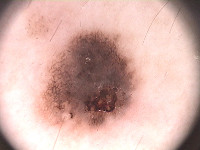</td><td>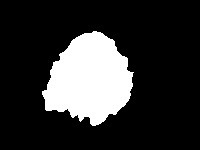</td></tr></table>

2. Разархивируем .rar файл.
3. Обратите внимание, что папка  `PH2 Dataset images` должна лежать там же где и ipynb notebook.

Это фотографии двух типов **поражений кожи:** меланома и родинки.
В данном задании мы не будем заниматься их классификацией, а будем **сегментировать** их.

In [ ]:
import os
import random

import numpy as np
import torch
import math
import numbers

import torch
from torch import nn
from torch.nn import functional as F

SEED = 0

def enable_reproducibility(seed=SEED, raise_if_no_deterministic=True):
    # https://pytorch.org/docs/stable/notes/randomness.html#avoiding-nondeterministic-algorithms
    if raise_if_no_deterministic:
        torch.use_deterministic_algorithms(True)

    torch.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)

train_on_gpu = torch.cuda.is_available()

if not train_on_gpu:
    print('CUDA is not available.  Training on CPU ...')
    device = torch.device("cpu")
else:
    print('CUDA is available!  Training on GPU ...')
    device = torch.device("cuda")

CUDA is available!  Training on GPU ...


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [ ]:
#!unzip -q /content/gdrive/My\ Drive/PH2Dataset -d train

In [ ]:
!wget -c https://www.dropbox.com/s/1cii0sgkcgu534k/PH2Dataset.rar

--2022-12-04 17:21:53--  https://www.dropbox.com/s/1cii0sgkcgu534k/PH2Dataset.rar
Resolving www.dropbox.com (www.dropbox.com)... 162.125.66.18, 2620:100:6021:18::a27d:4112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.66.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/1cii0sgkcgu534k/PH2Dataset.rar [following]
--2022-12-04 17:21:53--  https://www.dropbox.com/s/raw/1cii0sgkcgu534k/PH2Dataset.rar
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc0302c0aec8c2f757ea8f30f458.dl.dropboxusercontent.com/cd/0/inline/Bx8nOJ6WCnrHZVkRRoMTgJBYFWMck98zJmtTBgCTr9bt3cgm91hyuYw4chIJrHmNLQyfgwyH96qrC04L0_RzpY_wPHQ-SO0rzj4zCVKEq31FxWKfN9f7PaIZ1vU3jsS6QNV7_7prCLYgTfk2fCW-D6ZZr0RrVV8_EEanMwfiL1DCDg/file# [following]
--2022-12-04 17:21:53--  https://uc0302c0aec8c2f757ea8f30f458.dl.dropboxusercontent.com/cd/0/inline/Bx8nOJ6WCnrHZVkRRoMTgJBYFWMck98zJmtTBgCTr9bt3cgm91hyuYw4chIJrHmNLQyfgwy

In [ ]:
!ls

PH2Dataset.rar	sample_data


In [ ]:
#!ls train

PH2Dataset


In [ ]:
get_ipython().system_raw("unrar x PH2Dataset.rar")

Стуктура датасета у нас следующая:

    IMD_002/
        IMD002_Dermoscopic_Image/
            IMD002.bmp
        IMD002_lesion/
            IMD002_lesion.bmp
        IMD002_roi/
            ...
    IMD_003/
        ...
        ...

 Здесь `X.bmp` — изображение, которое нужно сегментировать, `X_lesion.bmp` — результат сегментации.

Для загрузки датасета можно использовать skimage: [`skimage.io.imread()`](https://scikit-image.org/docs/dev/api/skimage.io.html)

In [ ]:
images = []
lesions = []
from skimage.io import imread
import os
root = 'PH2Dataset' #Path('/content/train/PH2Dataset')

for root, dirs, files in os.walk(os.path.join(root, 'PH2 Dataset images')):
    if root.endswith('_Dermoscopic_Image'):
        images.append(imread(os.path.join(root, files[0])))
    if root.endswith('_lesion'):
        lesions.append(imread(os.path.join(root, files[0])))

Изображения имеют разные размеры. Давайте изменим их размер на $256\times256 $ пикселей. Для изменения размера изображений можно использовать [`skimage.transform.resize()`](https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize).
Эта функция также автоматически нормализует изображения в диапазоне $[0,1]$.


In [ ]:
from skimage.transform import resize
size = (256, 256)
X = [resize(x, size, mode='constant', anti_aliasing=True,) for x in images]
Y = [resize(y, size, mode='constant', anti_aliasing=False) > 0.5 for y in lesions]

In [ ]:
import numpy as np
X = np.array(X, np.float32)
Y = np.array(Y, np.float32)
print(f'Loaded {len(X)} images')

Loaded 200 images


In [ ]:
len(lesions)

200

Чтобы убедиться, что все корректно, мы нарисуем несколько изображений

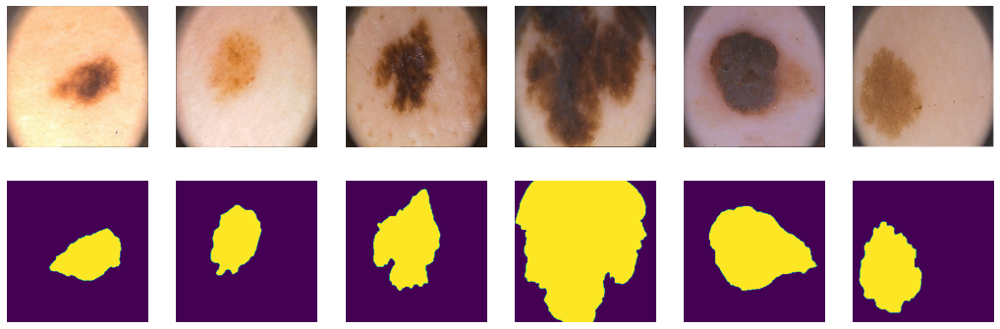

In [ ]:
import matplotlib.pyplot as plt
from IPython.display import clear_output

plt.figure(figsize=(18, 6))
for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.axis("off")
    plt.imshow(X[i])

    plt.subplot(2, 6, i+7)
    plt.axis("off")
    plt.imshow(Y[i])
plt.show();

Разделим наши 200 картинок на 100/50/50
 для обучения, валидации и теста соответственно

In [ ]:
ix = np.random.choice(len(X), len(X), False)
tr, val, ts = np.split(ix, [100, 150])

In [ ]:
print(len(tr), len(val), len(ts))

100 50 50


#### PyTorch DataLoader

In [ ]:
enable_reproducibility()


from torch.utils.data import DataLoader


BATCH_SIZE = 5
data_tr = DataLoader(list(zip(np.moveaxis(X[tr], 3, 1), Y[tr, np.newaxis])), 
                     batch_size=BATCH_SIZE, shuffle=True)
data_val = DataLoader(list(zip(np.moveaxis(X[val], 3, 1), Y[val, np.newaxis])),
                      batch_size=BATCH_SIZE, shuffle=False) #shuffle=True
data_ts = DataLoader(list(zip(np.moveaxis(X[ts], 3, 1), Y[ts, np.newaxis])),
                     batch_size=BATCH_SIZE, shuffle=False) #shuffle=True

In [ ]:
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


# Реализация различных архитектур:
Ваше задание будет состоять в том, чтобы написать несколько нейросетевых архитектур для решения задачи семантической сегментации. Сравнить их по качеству на тесте и испробовать различные лосс функции для них.

-----------------------------------------------------------------------------------------

# SegNet [2 балла]

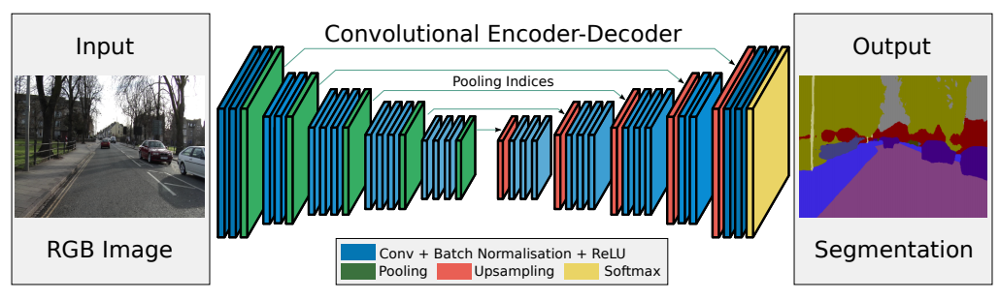

* Badrinarayanan, V., Kendall, A., & Cipolla, R. (2015). [SegNet: A deep convolutional
encoder-decoder architecture for image segmentation](https://arxiv.org/pdf/1511.00561.pdf)

Внимательно посмотрите из чего состоит модель и для чего выбраны те или иные блоки.

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F
from torchvision import models
import torch.optim as optim
from time import time

from matplotlib import rcParams

rcParams['figure.figsize'] = (15,4)

In [ ]:
class SegNet(nn.Module):
    def __init__(self):
        super().__init__()

        # encoder (downsampling)
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True)
        )
        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 256 -> 128
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True)
        )
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 128 -> 64
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True)
        )
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 64 -> 32
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True)
        )
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)  # 32 -> 16
#        self.enc_conv4 = nn.Sequential(
#            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
#            nn.BatchNorm2d(num_features=512),
#            nn.ReLU(inplace=True),
#
#            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
#            nn.BatchNorm2d(num_features=512),
#            nn.ReLU(inplace=True),
#    
#            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
#            nn.BatchNorm2d(num_features=512),
#            nn.ReLU(inplace=True),
#        )
#        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True) # 16 -> 8

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=1, padding=0, stride=1),
            nn.BatchNorm2d(num_features=1024),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=1, padding=0, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True)
        )
        
        # decoder (upsampling)
#        self.upsample4 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 8 -> 16
#        self.dec_conv4 = nn.Sequential(
#            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
#            nn.BatchNorm2d(num_features=512),
#            nn.ReLU(inplace=True),
#
#            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
#            nn.BatchNorm2d(num_features=512),
#            nn.ReLU(inplace=True),
#    
#            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
#            nn.BatchNorm2d(num_features=512),
#            nn.ReLU(inplace=True),
#        )
        self.upsample3 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 16 -> 32
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),
        )
        self.upsample2 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 32 -> 64
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True),
        )
        self.upsample1 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 64 -> 128
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),
        )
        self.upsample0 = nn.MaxUnpool2d(kernel_size=2, stride=2) # 128 -> 256
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True),
    
            nn.Conv2d(in_channels=64, out_channels=1, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=1),
        )

    def forward(self, x):
        
        # encoder
        e0, inds0 = self.pool0(self.enc_conv0(x))
        e1, inds1 = self.pool1(self.enc_conv1(e0))
        e2, inds2 = self.pool2(self.enc_conv2(e1))
        e3, inds3 = self.pool3(self.enc_conv3(e2))
        #e4, inds4 = self.pool4(self.enc_conv4(e3))

        # bottleneck
        b = self.bottleneck_conv(e3)
        
        # decoder
        #d4 = self.dec_conv4(self.upsample4(b, inds4))
        d3 = self.dec_conv3(self.upsample3(b, inds3))
        d2 = self.dec_conv2(self.upsample2(d3, inds2))
        d1 = self.dec_conv1(self.upsample1(d2, inds1))
        d0 = self.dec_conv0(self.upsample0(d1, inds0))
        return d0

In [ ]:
from torchsummary import summary

model = SegNet().to(device)
summary(model, (3, *size));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,928
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
         MaxPool2d-7  [[-1, 64, 128, 128], [-1, 64, 128, 128]]               0
            Conv2d-8        [-1, 128, 128, 128]          73,856
       BatchNorm2d-9        [-1, 128, 128, 128]             256
             ReLU-10        [-1, 128, 128, 128]               0
           Conv2d-11        [-1, 128, 128, 128]         147,584
      BatchNorm2d-12        [-1, 128, 128, 128]             256
             ReLU-13        [-1, 128, 128, 128]               0
        MaxPool2d-14  [[

## Метрика

В данном разделе предлагается использовать следующую метрику для оценки качества:

$I o U=\frac{\text {target } \cap \text { prediction }}{\text {target } \cup{prediction }}$

Пересечение (A ∩ B) состоит из пикселей, найденных как в маске предсказания, так и в основной маске истины, тогда как объединение (A ∪ B) просто состоит из всех пикселей, найденных либо в маске предсказания, либо в целевой маске.


Для примера посмотрим на истину (слева) и предсказание (справа):
![alt text](https://www.jeremyjordan.me/content/images/2018/05/target_prediction.png)


Тогда пересечение и объединение будет выглядеть так:

![alt text](https://www.jeremyjordan.me/content/images/2018/05/intersection_union.png)

In [ ]:
def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(1).byte()  # BATCH x 1 x H x W => BATCH x H x W
    labels = labels.squeeze(1).byte()
    SMOOTH = 1e-8
    intersection = (outputs & labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0
    
    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0
    
    thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds
    
    return thresholded.mean().item()  # 

## Функция потерь [1 балл]

Не менее важным, чем построение архитектуры, является определение **оптимизатора** и **функции потерь.**

Функция потерь - это то, что мы пытаемся минимизировать. Многие из них могут быть использованы для задачи бинарной семантической сегментации. 

Популярным методом для бинарной сегментации является *бинарная кросс-энтропия*, которая задается следующим образом:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

где $y$ это  таргет желаемого результата и $\hat y$ является выходом модели. $\sigma$ - это [*логистическая* функция](https://en.wikipedia.org/wiki/Sigmoid_function), который преобразует действительное число $\mathbb R$ в вероятность $[0,1]$.

Однако эта потеря страдает от проблем численной нестабильности. Самое главное, что $\lim_{x\rightarrow0}\log(x)=\infty$ приводит к неустойчивости в процессе оптимизации. Рекомендуется посмотреть следующее [упрощение](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits). Эта функция эквивалентна первой и не так подвержена численной неустойчивости:

$$\mathcal L_{BCE} = \hat y - y\hat y + \log\left(1+\exp(-\hat y)\right).$$

In [ ]:
def bce_loss(y_pred, y_real):
    loss = y_pred - y_real * y_pred + (1 + torch.exp(-y_pred)).log()
    return loss.mean()

## Тренировка [1 балл]

Мы определим цикл обучения в функции, чтобы мы могли повторно использовать его.

In [ ]:
from enum import Enum
from typing import Optional, Literal

from tqdm.notebook import tqdm, trange

class TrainType(Enum):
    TRAIN = "train"
    FULL = "full"

    def __str__(self):
        return self.value.lower()


MODEL_FILENAME_FMT = "{model_name}.{train_type}.{device_type}.tar"
MODEL_STORAGE_DIR = "./trained_models"

In [ ]:
def train_model(
        model, train_loader, val_loader, criterion, optimizer, epochs, device, model_output_to_predict,
        metrics, main_metric_name=None, save_best=False, model_name=None, logs_dir=MODEL_STORAGE_DIR,
        lr_scheduler=None, print_samples_callback=None):
    if model_name is None:
        model_name = model.__class__.__name__
    if not isinstance(metrics, dict):
        metrics = {metric.__name__: metric for metric in metrics}
    if save_best and main_metric_name is None:
        raise ValueError("You should set `main_metric_name` when `save_best` is True")
    if main_metric_name not in metrics:
        raise ValueError("`main_metric_name` \"{}\" not found in `metrics`".format(main_metric_name))

    train_losses = []
    train_metrics = {name: [] for name in metrics}
    val_losses = []
    val_metrics = {name: [] for name in metrics}
    best_epoch = -1
    history = [
        train_losses,
        train_metrics,
        val_losses,
        val_metrics,
    ]
    model = model.to(device)
    best_metric_value = None
    with trange(1, epochs + 1, desc="epochs") as pbar:
        for i in pbar:
            train_loss, *train_ypt = epoch_train_stage(model, train_loader, criterion, optimizer, device, model_output_to_predict)
            train_losses.append(train_loss)
            for name, metric in metrics.items():
                train_metrics[name].append(metric(*train_ypt))
            val_loss, *val_ypt = epoch_val_stage(model, val_loader, criterion, device, model_output_to_predict)
            if lr_scheduler is not None:
                lr_scheduler.step()
            val_losses.append(val_loss)
            for name, metric in metrics.items():
                val_metrics[name].append(metric(*val_ypt))
            if save_best and (best_metric_value is None or best_metric_value < val_metrics[main_metric_name][-1]):
                best_metric_value = val_metrics[main_metric_name][-1]
                model_filename = MODEL_FILENAME_FMT.format(
                    model_name=model_name, train_type=TrainType.TRAIN, device_type=device.type)
                save_model(
                    model, optimizer, i, val_loss,
                    model_name=model_name,
                    path=os.path.join(logs_dir, model_filename),
                    lr_scheduler=lr_scheduler, metrics={name: value_list[-1] for name, value_list in val_metrics.items()})
            pbar.set_postfix(
                t_loss=train_loss, v_loss=val_loss,
                **{"t_" + name: value_list[-1] for name, value_list in train_metrics.items()},
                **{"v_" + name: value_list[-1] for name, value_list in val_metrics.items()})
            if print_samples_callback is not None:
                print_samples_callback(model)
    return history

In [ ]:
def refit(
        model, data_loader, criterion, optimizer, epochs, device,
        metrics, main_metric_name=None, save_best=False, model_name=None, logs_dir=MODEL_STORAGE_DIR, lr_scheduler=None):
    if model_name is None:
        model_name = model.__class__.__name__
    if not isinstance(metrics, dict):
        metrics = {metric.__name__: metric for metric in metrics}
    if save_best and main_metric_name is None:
        raise ValueError("You should set `main_metric_name` when `save_best` is True")
    if main_metric_name not in metrics:
        raise ValueError("`main_metric_name` \"{}\" not found in `metrics`".format(main_metric_name))

    train_losses = []
    train_metrics = {name: [] for name in metrics}
    best_epoch = -1
    history = [
        train_losses,
        train_metrics
    ]
    model = model.to(device)
    best_metric_value = None
    with trange(1, epochs + 1, desc="epochs") as pbar:
        for i in pbar:
            train_loss, *train_ypt = epoch_train_stage(model, data_loader, criterion, optimizer, device)
            train_losses.append(train_loss)
            for name, metric in metrics.items():
                train_metrics[name].append(metric(*train_ypt))
            if lr_scheduler is not None:
                lr_scheduler.step()
            if save_best and (best_metric_value is None or best_metric_value < train_metrics[main_metric_name][-1]):
                best_metric_value = train_metrics[main_metric_name][-1]
                model_filename = MODEL_FILENAME_FMT.format(
                    model_name=model_name, train_type=TrainType.FULL, device_type=device.type)
                save_model(
                    model, optimizer, i, train_loss,
                    model_name=model_name,
                    path=os.path.join(logs_dir, model_filename),
                    lr_scheduler=lr_scheduler, metrics={name: value_list[-1] for name, value_list in train_metrics.items()})
            pbar.set_postfix(
                t_loss=train_loss,
                **{"t_" + name: value_list[-1] for name, value_list in train_metrics.items()})
    return history

In [ ]:
def epoch_train_stage(model, data_loader, criterion, optimizer, device, model_output_to_predict):
    loss_sum = 0
    y_true = []
    y_pred = []
    was_training = model.training
    model.train()
    for data, labels in tqdm(data_loader, desc="train batches", leave=False):
        data, labels = data.to(device), labels.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, labels)
        loss.backward()
        optimizer.step()

        loss_sum += loss.item()
        pred = model_output_to_predict(output)
        y_true.append(labels)
        y_pred.append(pred)
    with torch.no_grad():
        y_true = torch.cat(y_true)
        y_pred = torch.cat(y_pred)
    model.train(was_training)
    return loss_sum / len(data_loader), y_pred, y_true

In [ ]:
def epoch_val_stage(model, data_loader, criterion, device, model_output_to_predict):
    loss_sum = 0
    y_true = []
    y_pred = []
    was_training = model.training
    model.eval()
    with torch.no_grad():
        for data, labels in tqdm(data_loader, desc="val batches", leave=False):
            data, labels = data.to(device), labels.to(device)
            output = model(data)
            loss = criterion(output, labels)

            loss_sum += loss.item()
            pred = model_output_to_predict(output)
            y_true.append(labels)
            y_pred.append(pred)

        y_true = torch.cat(y_true)
        y_pred = torch.cat(y_pred)

    model.train(was_training)
    return loss_sum / len(data_loader), y_pred, y_true

In [ ]:
def print_best_epoch(metric_values, metric_name='metric', type: Optional[Literal['max', 'min']]='max', model_name='model'):
    if type == 'max':
        func = np.argmax
    elif type == 'min':
        func == np.argmin
    else:
        raise ValueError("`type` must be 'min' or 'max'")
    epoch = func(metric_values)
    best_metric_value = metric_values[epoch]
    epoch += 1
    print("{}: best {} value {} on {} epoch.".format(model_name, metric_name, best_metric_value, epoch))

def multiclass_get_labels(output):
    return output.argmax(-1)

def one_class_get_labels(output):
    return torch.sigmoid(output) >= 0.5

In [ ]:
def save_model(model, optimizer, epoch, loss, model_name, path, lr_scheduler=None, metrics=None):
    state = {
        'model_name': model_name,
        'model_state': model.state_dict(),
        'optimizer_state': optimizer.state_dict(),
        'lr_scheduler_state': None if lr_scheduler is None else lr_scheduler.state_dict(),
        'epoch': epoch,
        'loss': loss,
        'metrics': metrics
    }
    directory = os.path.dirname(os.path.abspath(path))
    os.makedirs(directory, exist_ok=True)
    torch.save(state, path)

In [ ]:
def load_model_state_and_info(model_name, train_type, device_type):
    path = os.path.join(
        MODEL_STORAGE_DIR,
        MODEL_FILENAME_FMT.format(
            model_name=model_name,
            train_type=train_type,
            device_type=device_type
        )
    )
    return torch.load(path)

In [ ]:
def show_plots(train_loss, train_metrics, val_loss, val_metrics, model_name=""):
    plt.figure(figsize=(15, 9))
    plt.plot(np.arange(1, len(train_loss) + 1), train_loss, label="train_loss")
    plt.plot(np.arange(1, len(val_loss) + 1), val_loss, label="val_loss")
    best_epoch = np.argmin(val_loss) + 1
    plt.axvline(best_epoch, color='r', label="best epoch by loss")
    plt.legend(loc='best')
    plt.title(model_name)
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.show()
    
    plt.figure(figsize=(15, 9))
    for name, values in train_metrics.items():
        plt.plot(np.arange(1, len(values) + 1), values, label="train_{}".format(name))
    for name, values in val_metrics.items():
        plt.plot(np.arange(1, len(values) + 1), values, label="val_{}".format(name))
        best_epoch = np.argmax(values) + 1
        plt.axvline(best_epoch, color='r', label="best epoch by {}".format(name))
    plt.legend(loc='best')
    plt.title(model_name)
    plt.xlabel("epoch")
    plt.ylabel("metric")
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
from IPython.display import clear_output

enable_reproducibility()

batch_val = next(iter(data_val))

def show_some_samples(
        model, batch_val=batch_val, leave_only_last=True,
        title=f"Samples from given batch_val (current epoch)"):
    # show intermediate results
    X_val, Y_val = batch_val
    was_training = model.training
    model.eval()  # testing mode
    with torch.no_grad():
        Y_hat = torch.sigmoid(model(X_val.to(device))).cpu()
        Y_pred_labels = Y_hat >= 0.5

    # Visualize tools
    if leave_only_last:
        clear_output(wait=True)
    vert, horiz = 3, 5
    plt.figure(figsize=(15, 9))
    for k in range(5):
        plt.subplot(vert, horiz, k + 1)
        plt.imshow(np.moveaxis(X_val[k].numpy(), 0, 2), cmap='gray')
        plt.title('Real')
        plt.axis('off')
        
        plt.subplot(vert, horiz, k + 6)
        plt.imshow(np.moveaxis(Y_val[k].numpy(), 0, 2).squeeze(-1), cmap='gray')
        plt.title('Ground truth')
        plt.axis('off')
        
        plt.subplot(vert, horiz, k + 11)
        plt.imshow(Y_pred_labels[k, 0].numpy(), cmap='gray')
        plt.title('Predicted labels')
        plt.axis('off')
    plt.suptitle(title)
    plt.show()
    model.train(was_training)

## Инференс [1 балл]

После обучения модели эту функцию можно использовать для прогнозирования сегментации на новых данных:

In [ ]:
def predict(model, data):
    model.eval()  # testing mode
    Y_pred = []
    with torch.no_grad():
        Y_pred.extend([(torch.sigmoid(model(X_batch)) >= 0.5) for X_batch, _ in data])
    return torch.cat(Y_pred)

In [ ]:
def score_model(model, metric, data):
    model.eval()  # testing mode
    y_pred = []
    y_label = []
    with torch.no_grad():
        for X_batch, Y_label in data:
            y_label.append(Y_label.to(device))
            y_pred.append(torch.sigmoid(model(X_batch.to(device))) >= 0.5)
    y_pred = torch.cat(y_pred)
    y_label = torch.cat(y_label)
    return metric(y_pred, y_label)

## Основной момент: обучение

Обучите вашу модель. Обратите внимание, что обучать необходимо до сходимости. Если указанного количества эпох (20) не хватило, попробуйте изменять количество эпох до сходимости алгоритма. Сходимость определяйте по изменению функции потерь на валидационной выборке.
 С параметрами оптимизатора можно спокойно играть, пока вы не найдете лучший вариант для себя.


In [ ]:
models_data = {
    "model & loss": [],
    "best epoch": [],
    "train loss": [],
    "val IoU": [],
    "test IoU": [],
}

def update_models_data(model_name, best_epoch, train_loss, val_metric, test_metric):
    models_data["model & loss"].append(model_name)
    models_data["best epoch"].append(best_epoch)
    models_data["train loss"].append(train_loss)
    models_data["val IoU"].append(val_metric)
    models_data["test IoU"].append(test_metric)

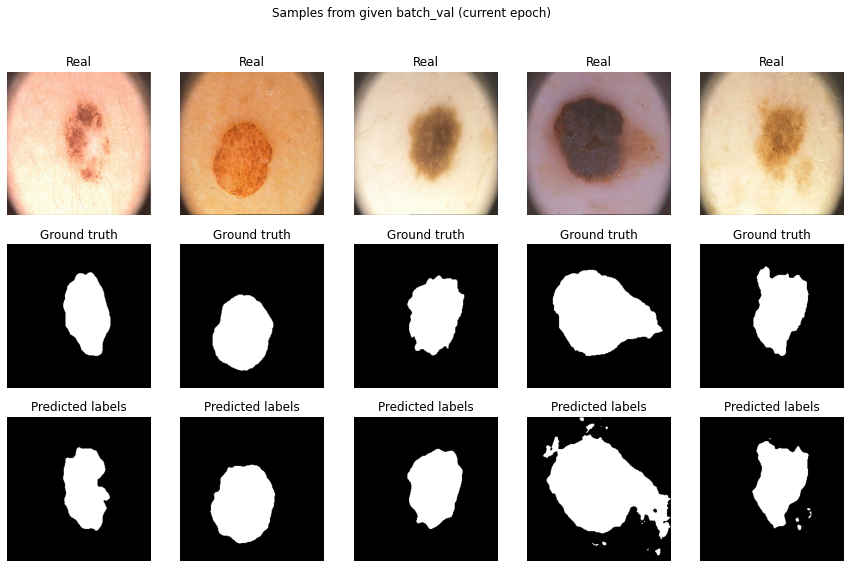

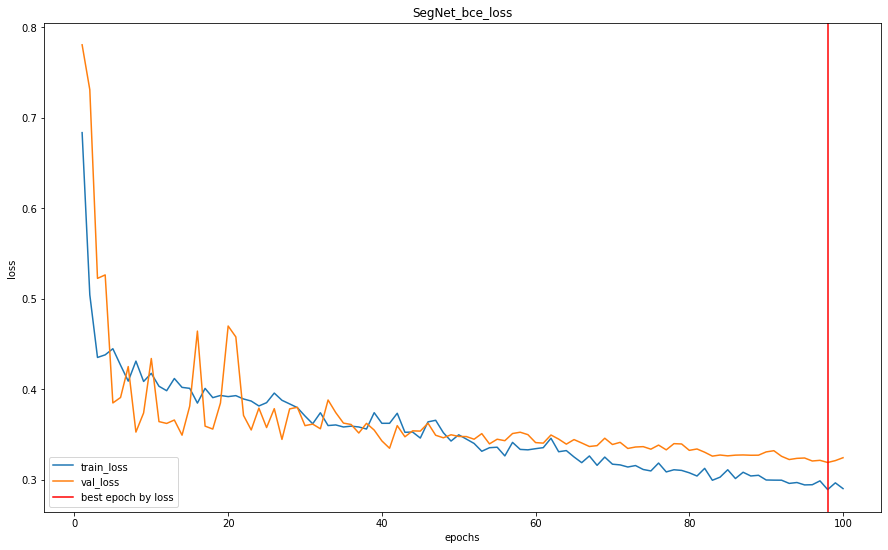

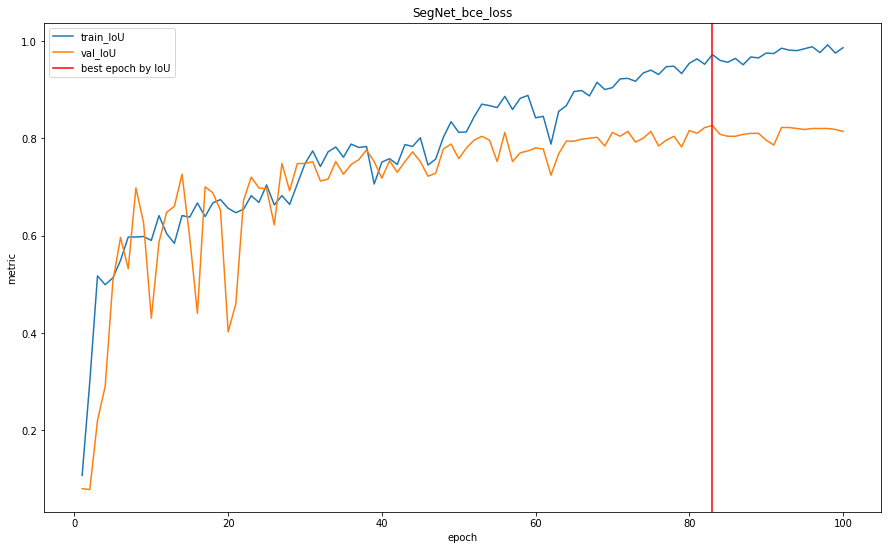

SegNet_bce_loss: best IoU value 0.8260000348091125 on 83 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_bce = SegNet().to(device)
model_name = "SegNet_bce_loss"
criterion = bce_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_bce.parameters(), lr=1e-4)

sn_train_loss_with_bce, sn_train_metrics_with_bce, sn_val_loss_with_bce, sn_val_metrics_with_bce = train_model(
    model_bce, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    sn_train_loss_with_bce, sn_train_metrics_with_bce, 
    sn_val_loss_with_bce, sn_val_metrics_with_bce,
    model_name=model_name)
print_best_epoch(
    sn_val_metrics_with_bce[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

In [ ]:
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_bce.load_state_dict(state['model_state'])

best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_bce, iou_pytorch, data_val)
test_score = score_model(model_bce, iou_pytorch, data_ts)

update_models_data("SegNet & bce loss", best_epoch, train_loss, val_score, test_score)
print('val_score_with_bce:', val_score)
print('test_score_with_bce:', test_score)

val_score_with_bce: 0.8260000348091125
test_score_with_bce: 0.8379999995231628


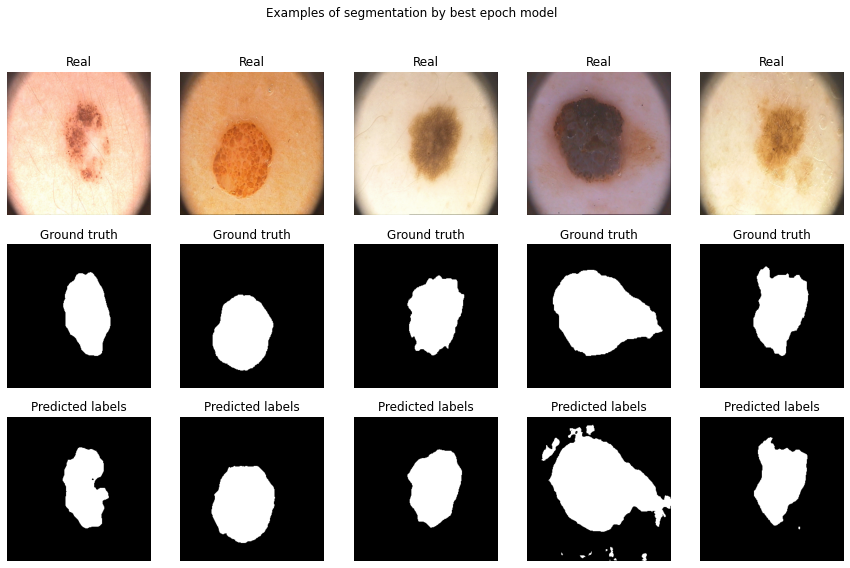

In [ ]:
show_some_samples(model_bce, title="Examples of segmentation by best epoch model")

Ответьте себе на вопрос: не переобучается ли моя модель?

Да, модель переробучается, но весьма незначительно. 

-----------------------------------------------------------------------------------------

## Дополнительные функции потерь [2 балла] 

 В данном разделе вам потребуется имплементировать две функции потерь:
 DICE и Focal loss. 
 Если у вас что-то не учится, велика вероятность, что вы ошиблись или учите слишком мало эпох, прежде чем бить тревогу попробуйте перебрать различные варианты и убедитесь, что во всех других сетапах сеть достигает желанного результата. СПОЙЛЕР: учиться она будет при всех лоссах, предложенных в этом задании.


**1. Dice coefficient:** Учитывая две маски $X$ и $Y$, общая метрика для измерения расстояния между этими двумя масками задается следующим образом:

$$D(X,Y)=\frac{2|X\cap Y|}{|X|+|Y|}$$

Эта функция не является дифференцируемой, но это необходимое свойство для градиентного спуска. В данном случае мы можем приблизить его с помощью:

$$\mathcal L_D(X,Y) = 1-\frac{1}{256 \times 256} \times \frac{\sum_i2X_iY_i}{\sum_iX_i+Y_i}.$$

Не забудьте подумать о численной нестабильности, возникающей в математической формуле.


In [ ]:
def dice_loss(logits, y_real, eps=1e-8):
    y_pred = torch.sigmoid(logits)
    num = (2 * y_pred * y_real).sum((-2, -1))
    den =  (y_pred + y_real).sum((-2, -1))
    res = 1 - ((num + eps) / (den + eps)).mean()
    return res

Проводим тестирование:

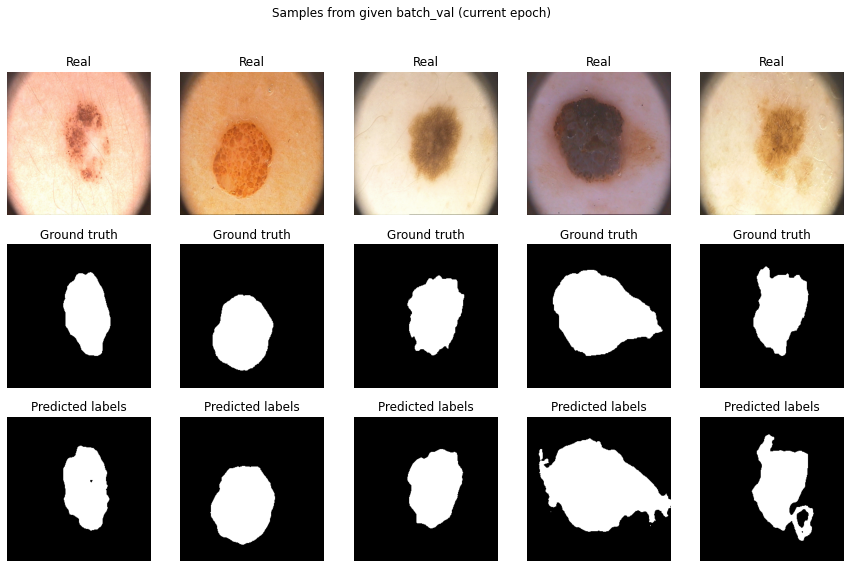

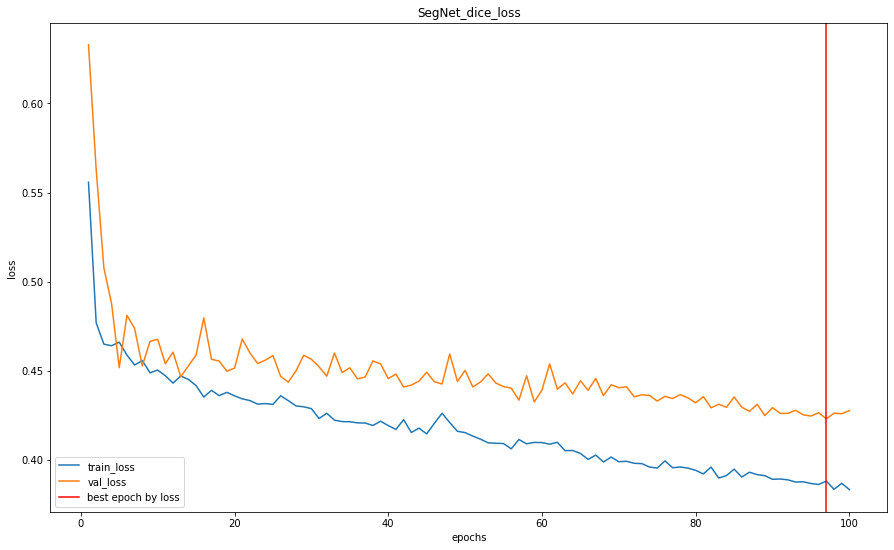

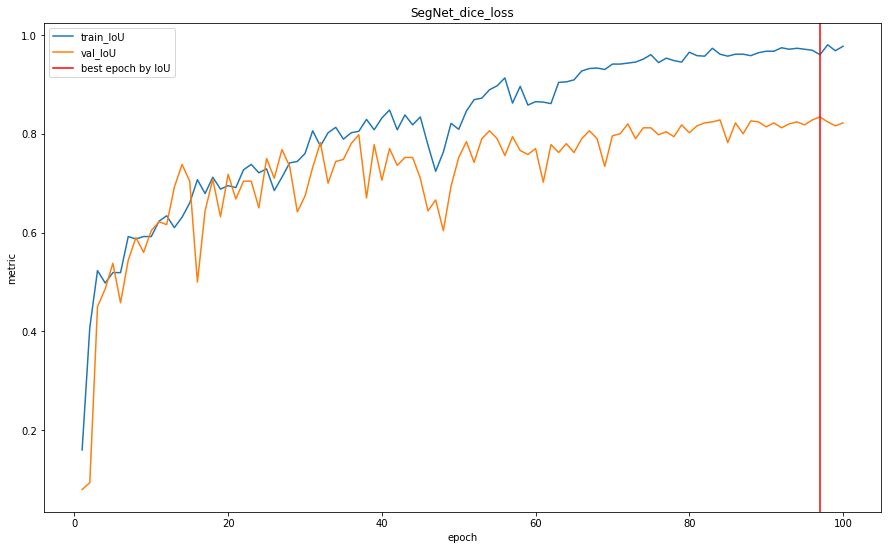

SegNet_dice_loss: best IoU value 0.8339999914169312 on 97 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_dice = SegNet().to(device)
model_name = "SegNet_dice_loss"
criterion = dice_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_dice.parameters(), lr=1e-4)


sn_train_loss_with_dl, sn_train_metrics_with_dl, sn_val_loss_with_dl, sn_val_metrics_with_dl = train_model(
    model_dice, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    sn_train_loss_with_dl, sn_train_metrics_with_dl, 
    sn_val_loss_with_dl, sn_val_metrics_with_dl,
    model_name=model_name)
print_best_epoch(
    sn_val_metrics_with_dl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

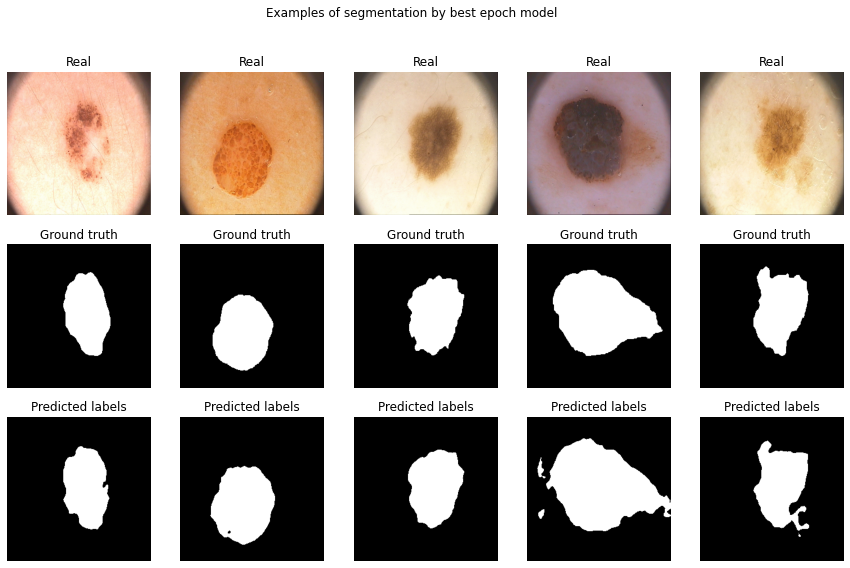

val_score_with_dice_loss: 0.8339999914169312
test_score_with_dice_loss: 0.8459999561309814


In [ ]:
model_name = "SegNet_dice_loss"
model_dice = SegNet().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_dice.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_dice, iou_pytorch, data_val)
test_score = score_model(model_dice, iou_pytorch, data_ts)

update_models_data("SegNet & dice loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_dice, title="Examples of segmentation by best epoch model")
print('val_score_with_dice_loss:', val_score)
print('test_score_with_dice_loss:', test_score)

[**2. Focal loss:**](https://arxiv.org/pdf/1708.02002.pdf) 

Окей, мы уже с вами умеем делать BCE loss:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Проблема с этой потерей заключается в том, что она имеет тенденцию приносить пользу классу **большинства** (фоновому) по отношению к классу **меньшинства** ( переднему). Поэтому обычно применяются весовые коэффициенты к каждому классу:

$$\mathcal L_{wBCE}(y, \hat y) = -\sum_i \alpha_i\left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Традиционно вес $\alpha_i$ определяется как обратная частота класса этого пикселя $i$, так что наблюдения миноритарного класса весят больше по отношению к классу большинства.

Еще одним недавним дополнением является взвешенный пиксельный вариант, которая взвешивает каждый пиксель по степени уверенности, которую мы имеем в предсказании этого пикселя.

$$\mathcal L_{focal}(y, \hat y) = -\sum_i \left[\left(1-\sigma(\hat y_i)\right)^\gamma y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Зафиксируем значение $\gamma=2$.

--------------------------------------------------------------------------------


In [ ]:
def focal_loss(y_pred, y_real, eps=1e-8, gamma=2):
    # y_pred =  # hint: torch.clamp
    pos_cls_freq = y_real.sum() / y_real.numel()
    alpha = y_real * (1 - pos_cls_freq) + (1 - y_real) * pos_cls_freq
    probs = torch.sigmoid(y_pred)
    pt = y_real * probs + (1 - y_real) * (1 - probs)
    weight = torch.pow(1 - pt, gamma)
    bce = y_real * y_pred - y_pred - torch.log(1 + torch.exp(-y_pred))
    your_loss = -(alpha * weight * bce).mean()
    return your_loss

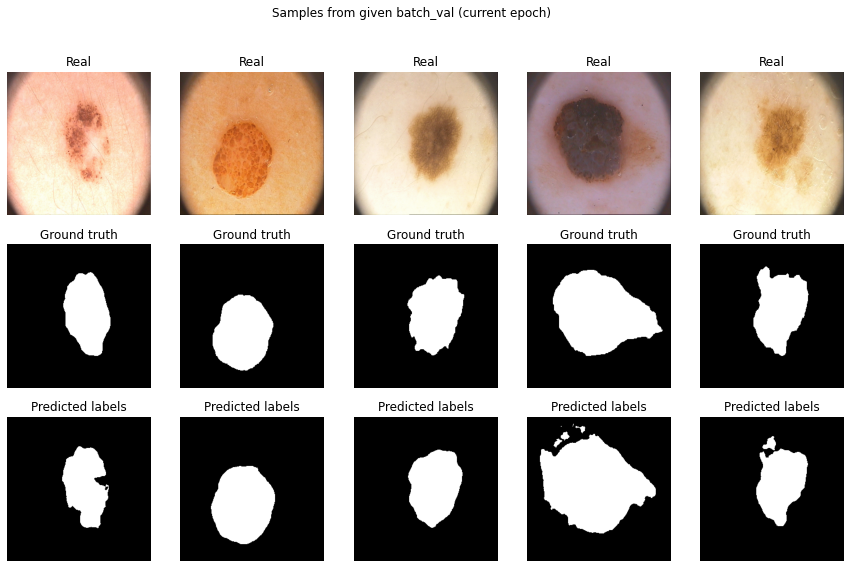

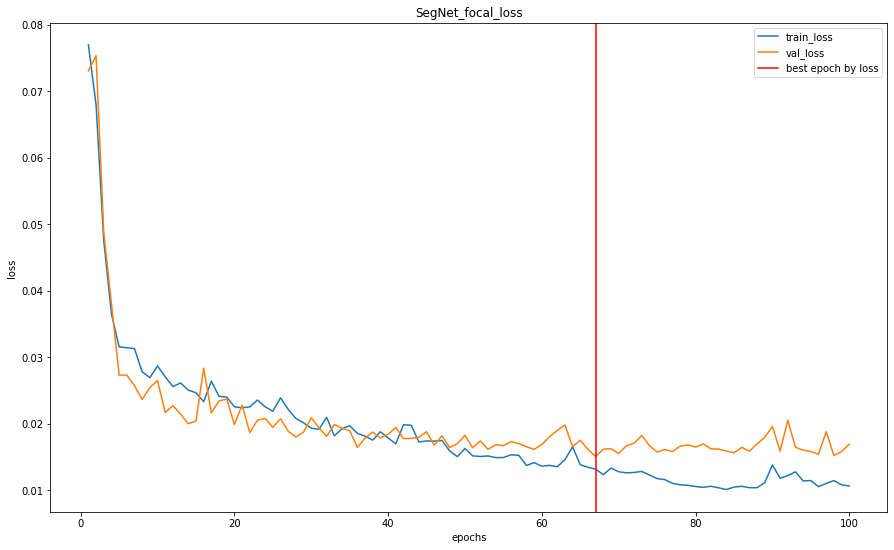

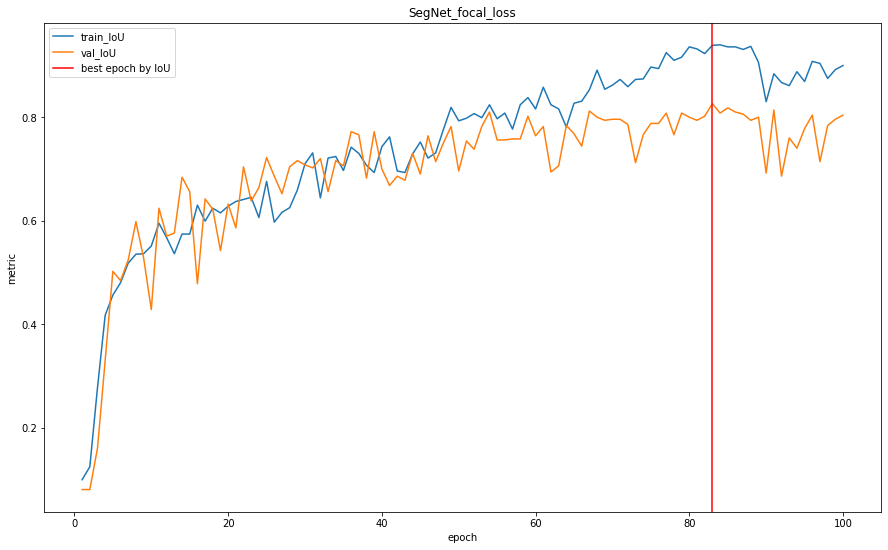

SegNet_focal_loss: best IoU value 0.8259999752044678 on 83 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_fl = SegNet().to(device)
model_name = "SegNet_focal_loss"
criterion = focal_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'

optimizer = torch.optim.Adam(model_fl.parameters(), lr=1e-4)

sn_train_loss_with_fl, sn_train_metrics_with_fl, sn_val_loss_with_fl, sn_val_metrics_with_fl = train_model(
    model_fl, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    sn_train_loss_with_fl, sn_train_metrics_with_fl, 
    sn_val_loss_with_fl, sn_val_metrics_with_fl,
    model_name=model_name)
print_best_epoch(
    sn_val_metrics_with_fl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

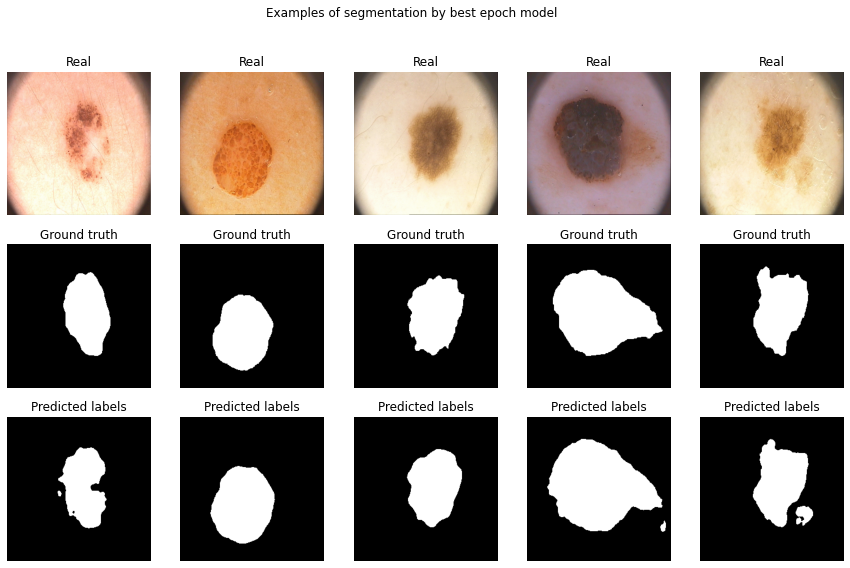

val_score_with_focal_loss: 0.8259999752044678
test_score_with_focal_loss: 0.8399999737739563


In [ ]:
model_name = "SegNet_focal_loss"
model_fl = SegNet().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_fl.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_fl, iou_pytorch, data_val)
test_score = score_model(model_fl, iou_pytorch, data_ts)

update_models_data("SegNet & focal loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_fl, title="Examples of segmentation by best epoch model")
print('val_score_with_focal_loss:', val_score)
print('test_score_with_focal_loss:', test_score)

----------------------------------------------------------------------------------------------

## [BONUS] Мир сегментационных лоссов [5 баллов]

В данном блоке предлагаем вам написать одну функцию потерь самостоятельно. Для этого необходимо прочитать статью и имплементировать ее. Кроме тако провести численное сравнение с предыдущими функциями.
Какие варианты? 

1) Можно учесть Total Variation
2) Lova
3) BCE но с Soft Targets (что-то типа label-smoothing для многослассовой классификации)
4) Любой другой 

* [Physiological Inspired Deep Neural Networks for Emotion Recognition](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=8472816&tag=1)". IEEE Access, 6, 53930-53943.

* [Boundary loss for highly unbalanced segmentation](https://arxiv.org/abs/1812.07032)

* [Tversky loss function for image segmentation using 3D fully convolutional deep networks](https://arxiv.org/abs/1706.05721)

* [Correlation Maximized Structural Similarity Loss for Semantic Segmentation](https://arxiv.org/abs/1910.08711)

* [Topology-Preserving Deep Image Segmentation](https://papers.nips.cc/paper/8803-topology-preserving-deep-image-segmentation)

Так как Тверский лосс очень похож на данные выше, то за него будет проставлено только 3 балла (при условии, если в модели нет ошибок при обучении). Постарайтесь сделать что-то интереснее.

## Correlation Maximized Structural Similarity Loss for Semantic Segmentation
Имплементировано на основе статьи: https://arxiv.org/abs/1910.08711

### Gaussian Smoothing
Информация взята отсюда: https://homepages.inf.ed.ac.uk/rbf/HIPR2/gsmooth.htm


Код вязт отсюда: https://discuss.pytorch.org/t/is-there-anyway-to-do-gaussian-filtering-for-an-image-2d-3d-in-pytorch/12351/10

In [ ]:
import math
import numbers

import torch
from torch import nn
from torch.nn import functional as F


class GaussianSmoothing(nn.Module):
    """
    Apply gaussian smoothing on a
    1d, 2d or 3d tensor. Filtering is performed seperately for each channel
    in the input using a depthwise convolution.
    Arguments:
        channels (int, sequence): Number of channels of the input tensors. Output will
            have this number of channels as well.
        kernel_size (int, sequence): Size of the gaussian kernel.
        sigma (float, sequence): Standard deviation of the gaussian kernel.
        dim (int, optional): The number of dimensions of the data.
            Default value is 2 (spatial).
    """

    def __init__(self, channels, kernel_size, sigma, dim=2):
        super(GaussianSmoothing, self).__init__()
        if isinstance(kernel_size, numbers.Number):
            kernel_size = [kernel_size] * dim
        if isinstance(sigma, numbers.Number):
            sigma = [sigma] * dim

        # The gaussian kernel is the product of the
        # gaussian function of each dimension.
        kernel = 1
        meshgrids = torch.meshgrid(
            [
                torch.arange(size, dtype=torch.float32)
                for size in kernel_size
            ]
        )
        for size, std, mgrid in zip(kernel_size, sigma, meshgrids):
            mean = (size - 1) / 2
            kernel *= 1 / (std * math.sqrt(2 * math.pi)) * \
                torch.exp(-((mgrid - mean) / std) ** 2 / 2)

        # Make sure sum of values in gaussian kernel equals 1.
        kernel = kernel / torch.sum(kernel)

        # Reshape to depthwise convolutional weight
        kernel = kernel.view(1, 1, *kernel.size())
        kernel = kernel.repeat(channels, *[1] * (kernel.dim() - 1))

        self.register_buffer('weight', kernel)
        self.groups = channels

        if dim == 1:
            self.conv = F.conv1d
        elif dim == 2:
            self.conv = F.conv2d
        elif dim == 3:
            self.conv = F.conv3d
        else:
            raise RuntimeError(
                'Only 1, 2 and 3 dimensions are supported. Received {}.'.format(
                    dim)
            )

    def forward(self, input):
        """
        Apply gaussian filter to input.
        Arguments:
            input (torch.Tensor): Input to apply gaussian filter on.
        Returns:
            filtered (torch.Tensor): Filtered output.
        """
        return self.conv(input, weight=self.weight, groups=self.groups)

### Estimation of the local statistic

In [ ]:
class LocalStatisticEstimation(nn.Module):
    def __init__(self, channels, kernel_size, sigma, eps=1e-8):
        super().__init__()
        self.gaussian_filter = GaussianSmoothing(
            channels, kernel_size, sigma, dim=2)
        padding = (kernel_size - 1) // 2
        self.pad = nn.ZeroPad2d(padding)
        self.eps = eps

    def forward(self, input):
        padded = self.pad(input)
        mean = self.gaussian_filter(padded)
        mean_subtracted_then_padded = self.pad(input - mean)
        filtered = self.gaussian_filter(mean_subtracted_then_padded ** 2)
        std = torch.sqrt(filtered + self.eps)
        return mean, std

### Structural similarity loss

In [ ]:
class CorrelationMaximizedStructuralSimilarityLoss(nn.modules.loss._Loss):
    def __init__(self, channels, kernel_size=3, sigma=1.5, beta=0.1, lambda_=0.5, stability_factor=0.01, eps=1e-8):
        super().__init__()
        self.local_statistic = LocalStatisticEstimation(
            channels, kernel_size, sigma)
        self.beta = beta
        self.lambda_ = lambda_
        self.stability_factor = stability_factor
        self.eps = eps

    def forward(self, input, target):
        probs = torch.sigmoid(input)
        probs_mean, probs_std = self.local_statistic(probs)
        target_mean, target_std = self.local_statistic(target)
        probs_normalized = (
            probs - probs_mean + self.stability_factor) / (probs_std + self.stability_factor)
        target_normalized = (
            target - target_mean + self.stability_factor) / (target_std + self.stability_factor)
        error_max = target_normalized.max() - target_normalized.min()
        error = torch.abs(target_normalized - probs_normalized)
        fnc = error > self.beta * error_max
        loss_bce = input - target * input  + torch.log(1 + torch.exp(-input))
        loss_lss = error * fnc * loss_bce
        M = fnc.sum((-2, -1))
        loss_lss_image = (loss_lss.sum((-2, -1)) + self.eps) / (M + self.eps)
        loss_bce_image = loss_bce.mean((-2, -1))
        return torch.mean(self.lambda_ * loss_bce_image + (1 - self.lambda_) * loss_lss_image)

### Applying to a model

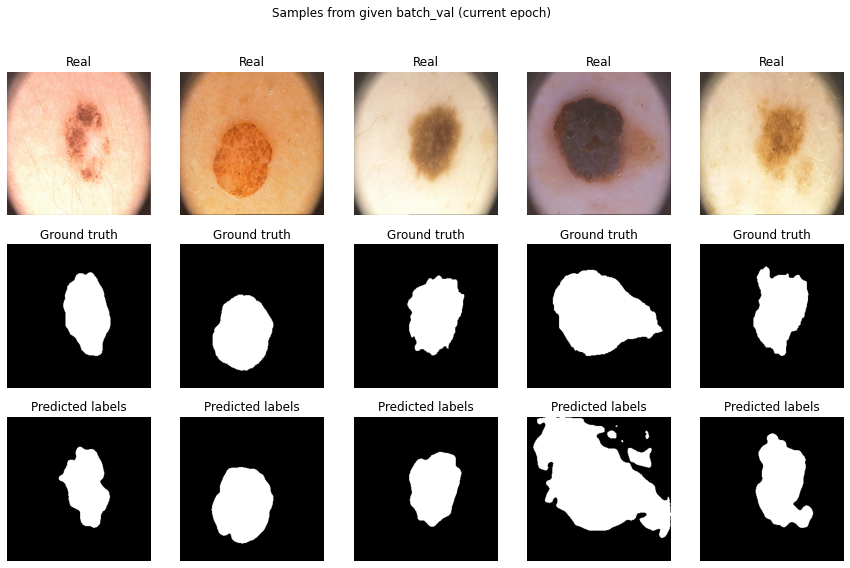

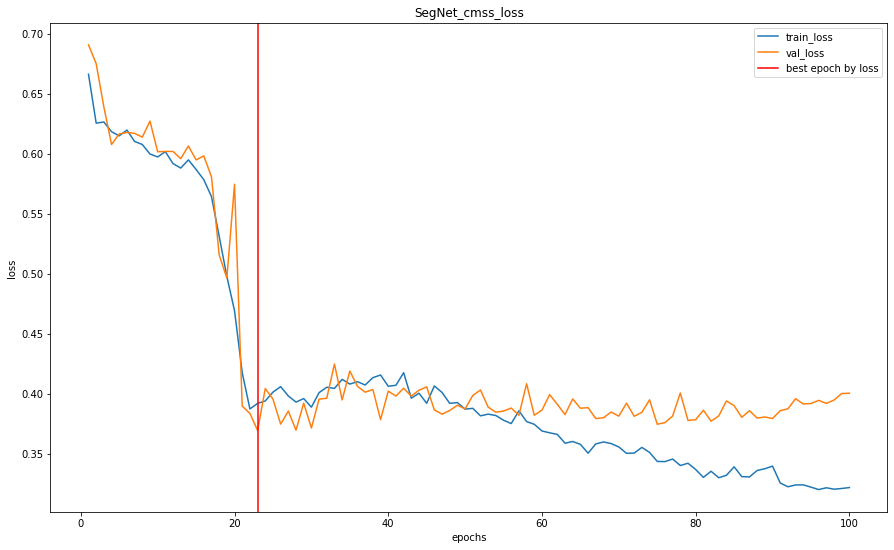

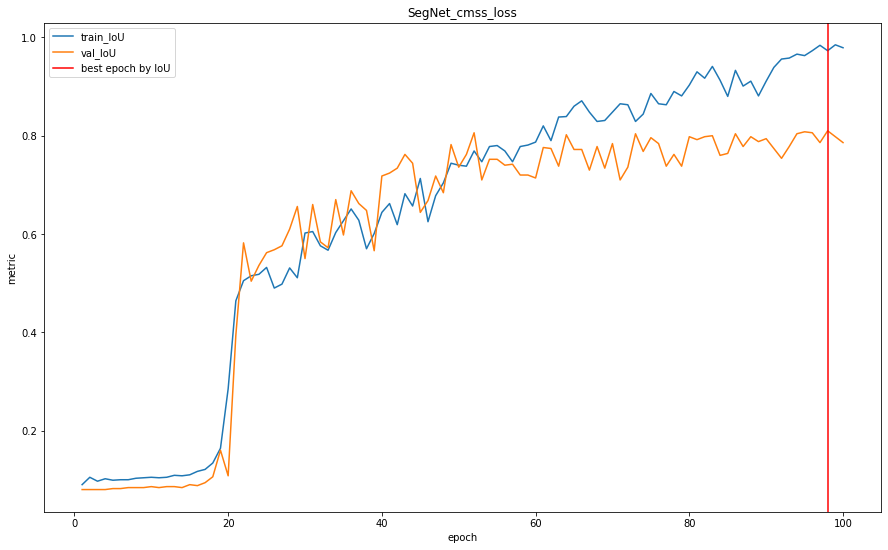

SegNet_cmss_loss: best IoU value 0.8100000619888306 on 98 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_cmssl = SegNet().to(device)
model_name = "SegNet_cmss_loss"
criterion = CorrelationMaximizedStructuralSimilarityLoss(channels=1).to(device)
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_cmssl.parameters(), lr=1e-4) 

sn_train_loss_with_cmssl, sn_train_metrics_with_cmssl, sn_val_loss_with_cmssl, sn_val_metrics_with_cmssl = train_model(
    model_cmssl, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    sn_train_loss_with_cmssl, sn_train_metrics_with_cmssl, 
    sn_val_loss_with_cmssl, sn_val_metrics_with_cmssl,
    model_name=model_name)
print_best_epoch(
    sn_val_metrics_with_cmssl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

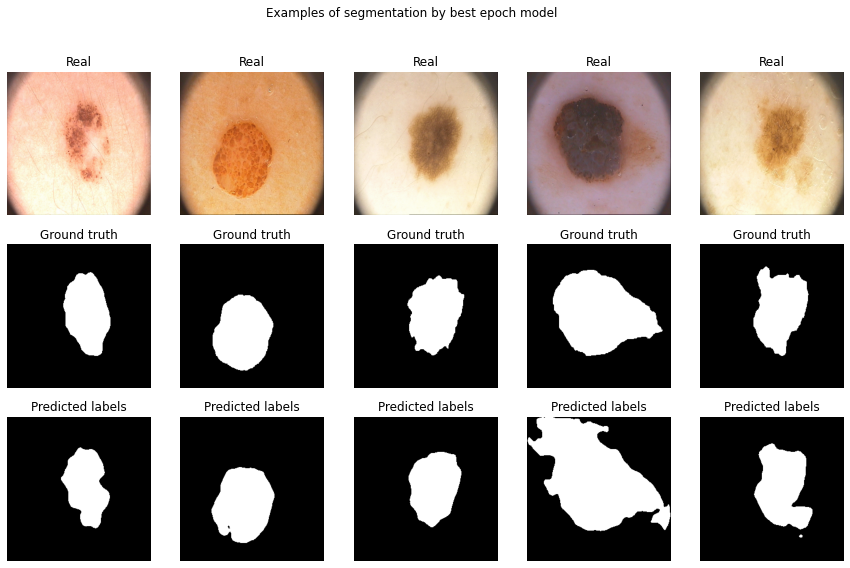

val_score_with_cmssl: 0.8100000619888306
test_score_with_cmssl: 0.8220000267028809


In [ ]:
model_name = "SegNet_cmss_loss"
model_cmssl = SegNet().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_cmssl.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_cmssl, iou_pytorch, data_val)
test_score = score_model(model_cmssl, iou_pytorch, data_ts)

update_models_data("SegNet & cmss loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_cmssl, title="Examples of segmentation by best epoch model")
print('val_score_with_cmssl:', val_score)
print('test_score_with_cmssl:', test_score)

-----------------------------------------------------------------------------------------

# U-Net [2 балла]

[**U-Net**](https://arxiv.org/abs/1505.04597) — это архитектура нейронной сети, которая получает изображение и выводит его. Первоначально он был задуман для семантической сегментации (как мы ее будем использовать), но он настолько успешен, что с тех пор используется в других контекстах. Получая на вход медицинское изображение, он выведет изображение в оттенках серого, где интенсивность каждого пикселя зависит от вероятности того, что этот пиксель принадлежит интересующей нас области.

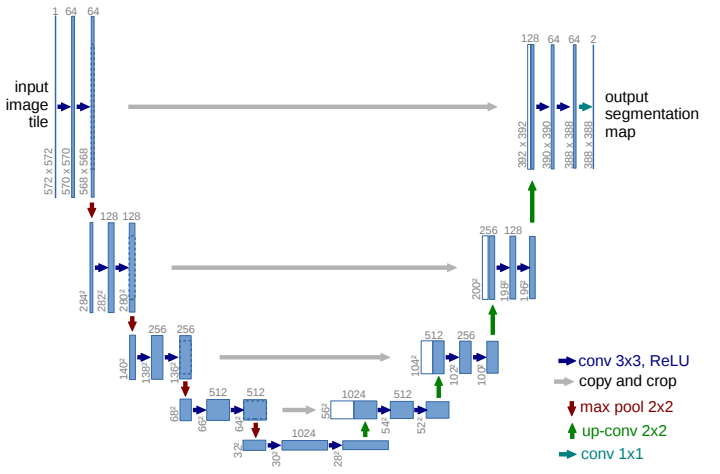

У нас в архитектуре все так же существует энкодер и декодер, как в **SegNet**, но отличительной особеностью данной модели являются *skip-conenctions*, соединяющие части декодера и энкодера. То есть для того чтобы передать на вход декодера тензор, мы конкатенируем симметричный выход с энкодера и выход предыдущего слоя декодера.

* Ronneberger, Olaf, Philipp Fischer, and Thomas Brox. "[U-Net: Convolutional networks for biomedical image segmentation.](https://arxiv.org/pdf/1505.04597.pdf)" International Conference on Medical image computing and computer-assisted intervention. Springer, Cham, 2015.

In [ ]:
from torchvision.transforms.functional import center_crop

class UNet(nn.Module):
    def __init__(self):
        super().__init__()

        # encoder (downsampling)
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True)
        )  
        self.pool0 = nn.MaxPool2d(kernel_size=2, stride=2)  # as in the original paper
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True)
        )  
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True)
        )  
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True)
        )  
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=1, padding=0, stride=1),
            nn.BatchNorm2d(num_features=1024),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=1, padding=0, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True)
        )

        # decoder (upsampling)
        self.upsample3 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512)
        )
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=512*2, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True)
        )
        self.upsample2 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256)
        )
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256*2, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True)
        )
        self.upsample1 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128)
        )
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=128*2, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True)
        )
        self.upsample0 = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64)
        )
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=64*2, out_channels=1, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=1),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=1, out_channels=1, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=1),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=1, out_channels=1, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=1)
        )

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        pooled = self.pool0(e0)
        e1 = self.enc_conv1(pooled)
        pooled = self.pool1(e1)
        e2 = self.enc_conv2(pooled)
        pooled = self.pool2(e2)
        e3 = self.enc_conv3(pooled)
        pooled = self.pool3(e3)

        # bottleneck
        b = self.bottleneck_conv(pooled)

        # decoder
        upsampled = self.upsample3(b)
        e3_cropped = center_crop(e3, upsampled.shape[-2:])
        concatenated = torch.cat((e3_cropped, upsampled), dim=1)
        d3 = self.dec_conv3(concatenated)
        upsampled = self.upsample2(d3)
        e2_cropped = center_crop(e2, upsampled.shape[-2:])
        concatenated = torch.cat((e2_cropped, upsampled), dim=1)
        d2 = self.dec_conv2(concatenated)
        upsampled = self.upsample1(d2)
        e1_cropped = center_crop(e1, upsampled.shape[-2:])
        concatenated = torch.cat((e1_cropped, upsampled), dim=1)
        d1 = self.dec_conv1(concatenated)
        upsampled = self.upsample0(d1)
        e0_cropped = center_crop(e0, upsampled.shape[-2:])
        concatenated = torch.cat((e0_cropped, upsampled), dim=1)
        d0 = self.dec_conv0(concatenated)  # no activation
        return d0

In [ ]:
from torchsummary import summary

model = UNet().to(device)
summary(model, (3, *size));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,928
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
         MaxPool2d-7         [-1, 64, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]          73,856
       BatchNorm2d-9        [-1, 128, 128, 128]             256
             ReLU-10        [-1, 128, 128, 128]               0
           Conv2d-11        [-1, 128, 128, 128]         147,584
      BatchNorm2d-12        [-1, 128, 128, 128]             256
             ReLU-13        [-1, 128, 128, 128]               0
        MaxPool2d-14          [-1, 128,

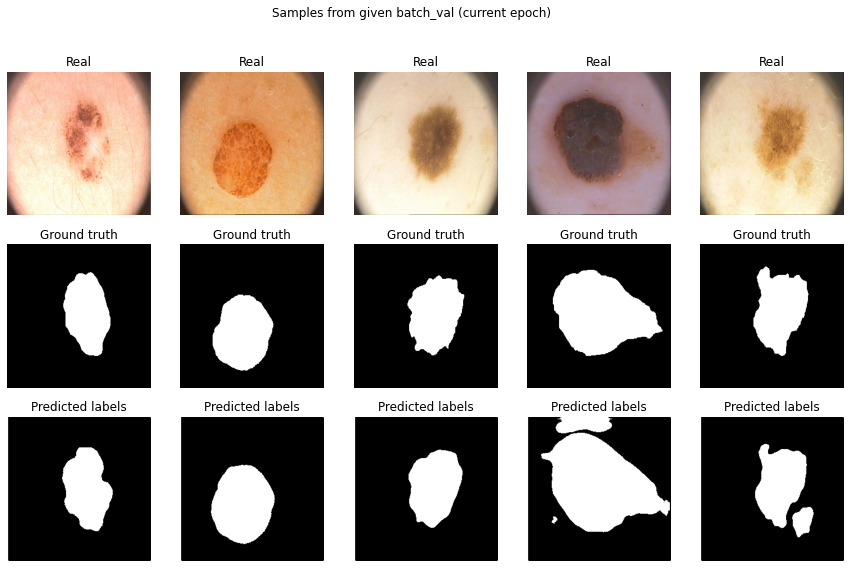

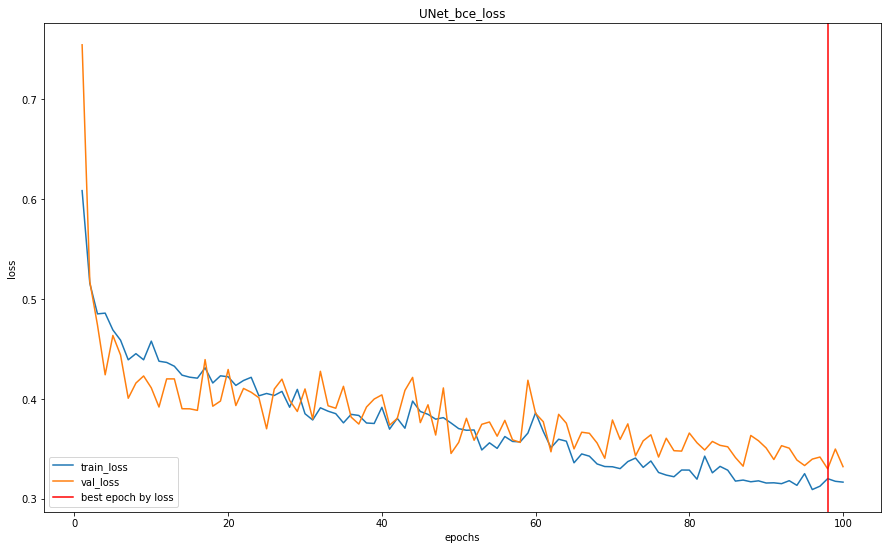

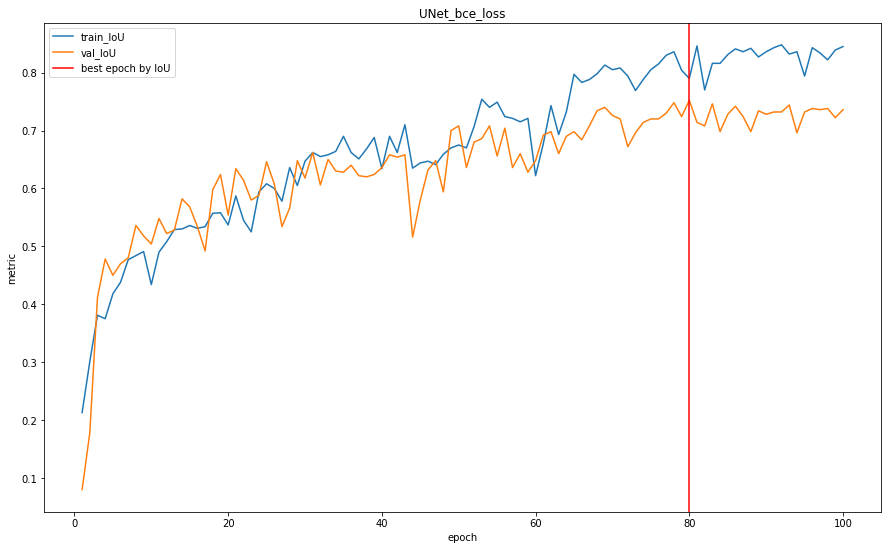

UNet_bce_loss: best IoU value 0.7519999742507935 on 80 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_bce_unet = UNet().to(device)
model_name = "UNet_bce_loss"
criterion = bce_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_bce_unet.parameters(), lr=1e-4) 

un_train_loss_with_bce, un_train_metrics_with_bce, un_val_loss_with_bce, un_val_metrics_with_bce = train_model(
    model_bce_unet, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un_train_loss_with_bce, un_train_metrics_with_bce, 
    un_val_loss_with_bce, un_val_metrics_with_bce,
    model_name=model_name)
print_best_epoch(
    un_val_metrics_with_bce[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

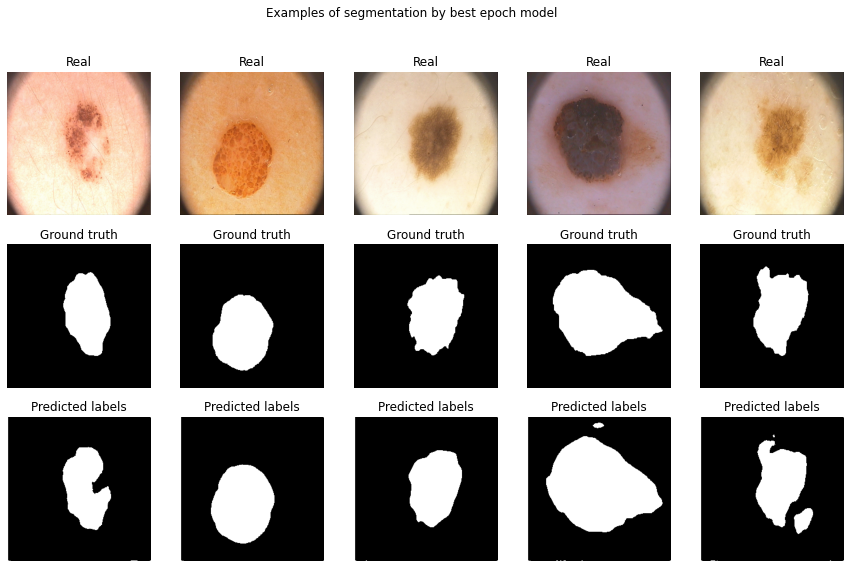

val_score_with_bce: 0.7519999742507935
test_score_with_bce: 0.7879999876022339


In [ ]:
model_name = "UNet_bce_loss"
model_bce_unet = UNet().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_bce_unet.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_bce_unet, iou_pytorch, data_val)
test_score = score_model(model_bce_unet, iou_pytorch, data_ts)

update_models_data("UNet & bce loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_bce_unet, title="Examples of segmentation by best epoch model")
print('val_score_with_bce:', val_score)
print('test_score_with_bce:', test_score)

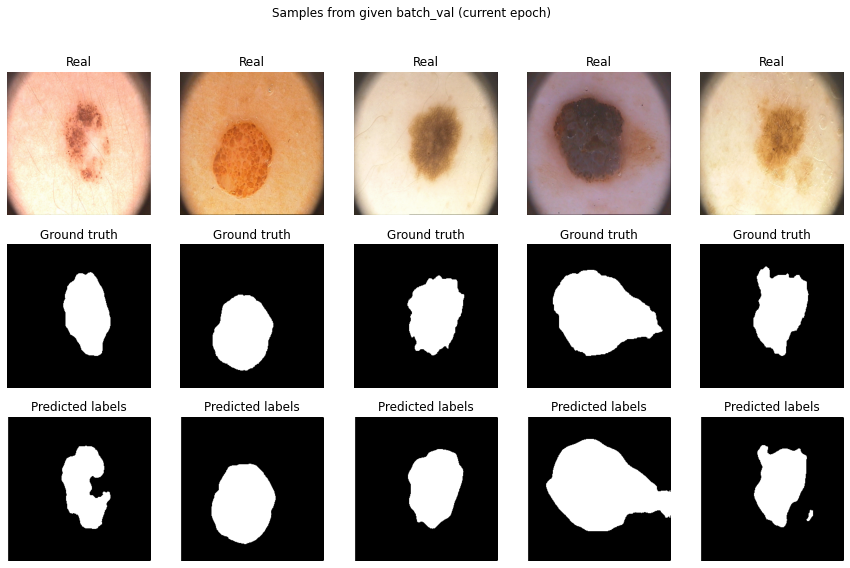

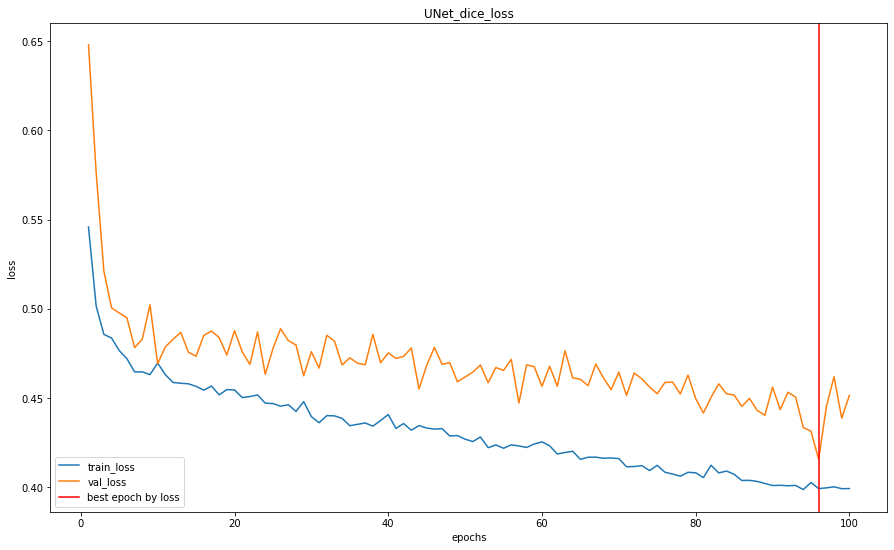

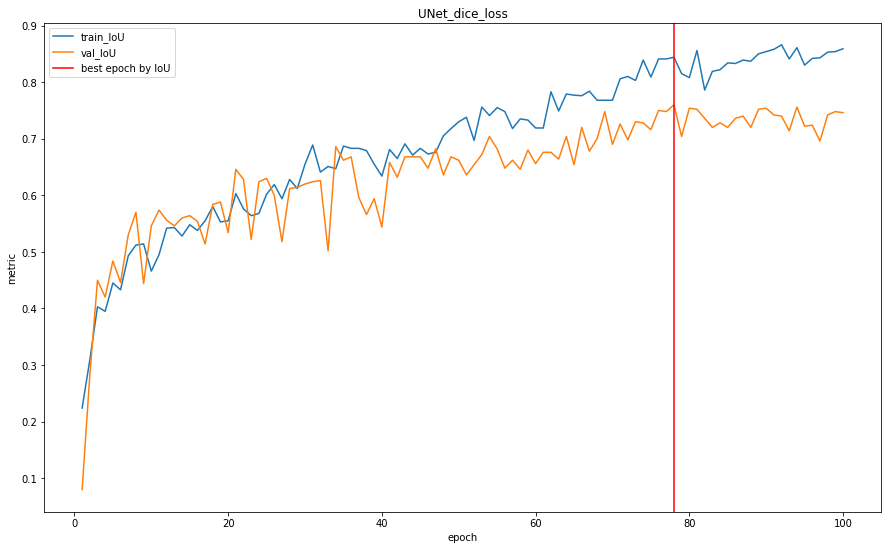

UNet_dice_loss: best IoU value 0.7599999904632568 on 78 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_dice_unet = UNet().to(device)
model_name = "UNet_dice_loss"
criterion = dice_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_dice_unet.parameters(), lr=1e-4) 

un_train_loss_with_dl, un_train_metrics_with_dl, un_val_loss_with_dl, un_val_metrics_with_dl = train_model(
    model_dice_unet, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un_train_loss_with_dl, un_train_metrics_with_dl, 
    un_val_loss_with_dl, un_val_metrics_with_dl,
    model_name=model_name)
print_best_epoch(
    un_val_metrics_with_dl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

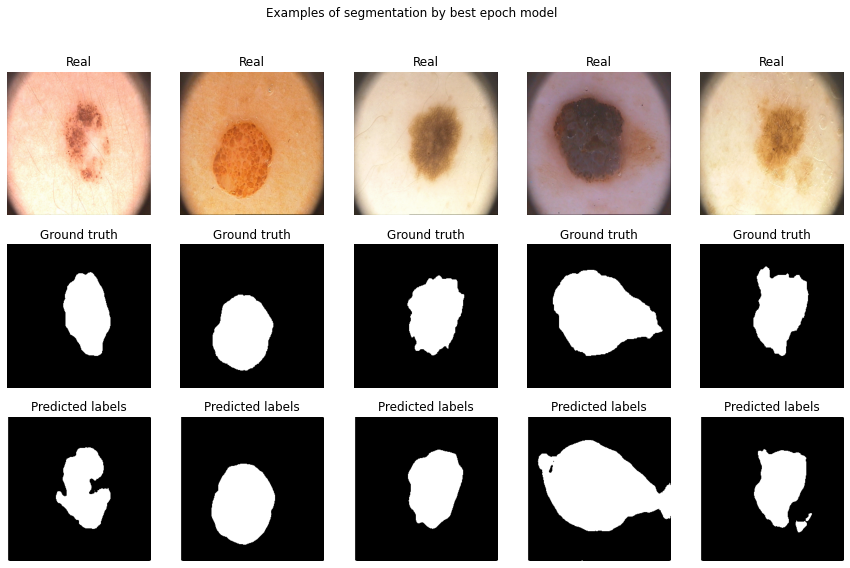

val_score_with_dice_loss: 0.7599999904632568
test_score_with_dice_loss: 0.7799999713897705


In [ ]:
model_name = "UNet_dice_loss"
model_dice_unet = UNet().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_dice_unet.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_dice_unet, iou_pytorch, data_val)
test_score = score_model(model_dice_unet, iou_pytorch, data_ts)

update_models_data("UNet & dice loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_dice_unet, title="Examples of segmentation by best epoch model")
print('val_score_with_dice_loss:', val_score)
print('test_score_with_dice_loss:', test_score)

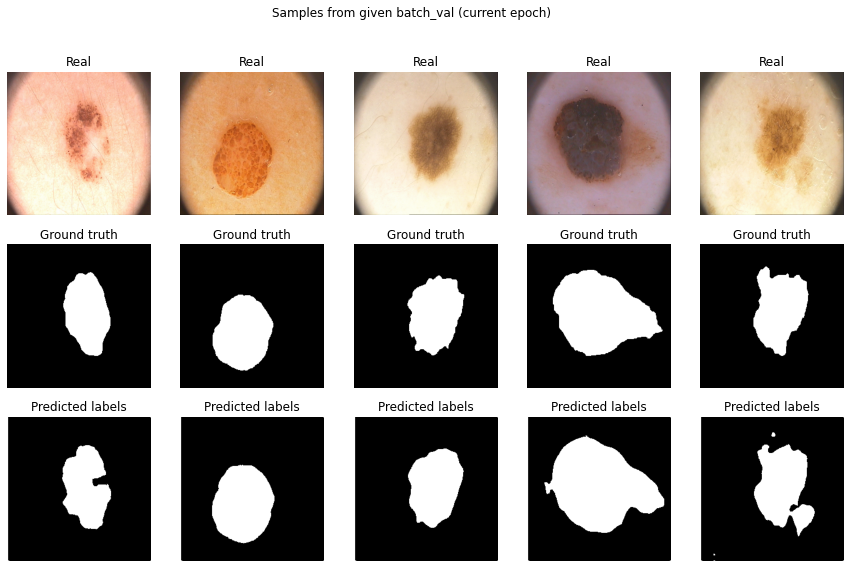

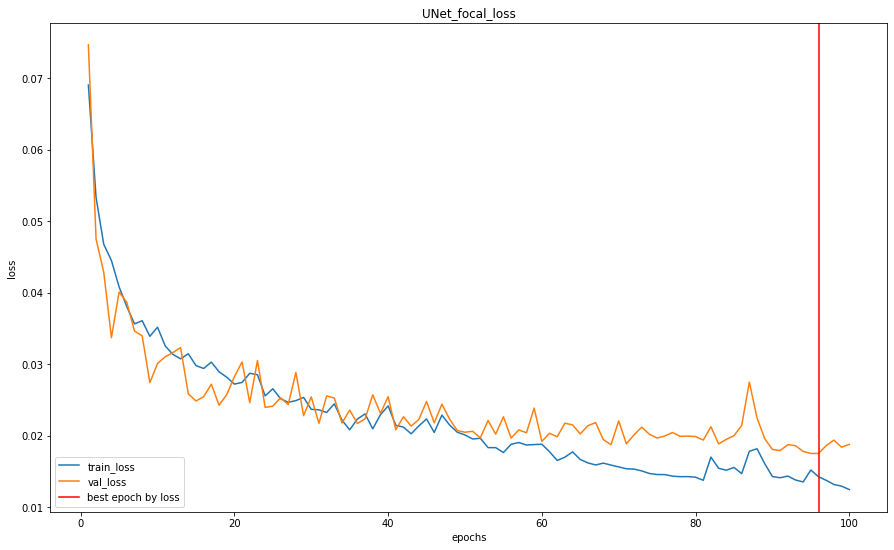

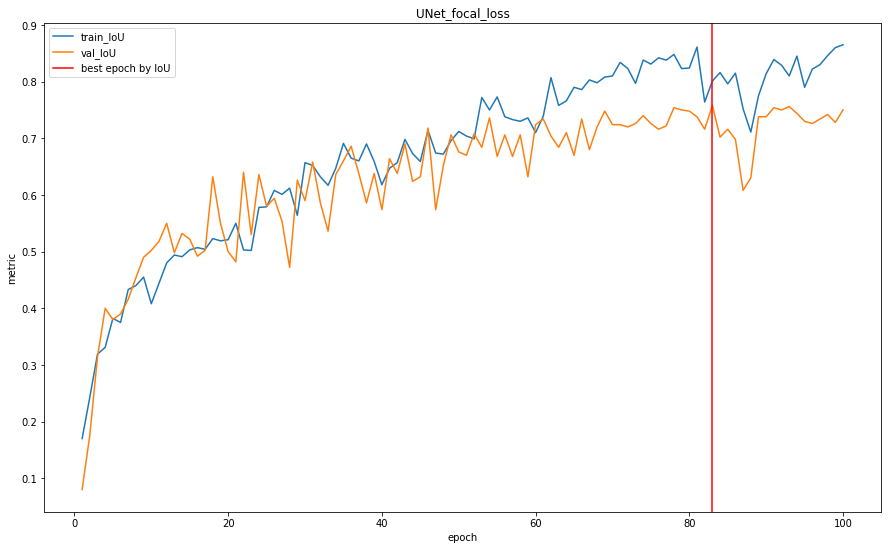

UNet_focal_loss: best IoU value 0.7580000162124634 on 83 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_fl_unet = UNet().to(device)
model_name = "UNet_focal_loss"
criterion = focal_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_fl_unet.parameters(), lr=1e-4) 

un_train_loss_with_fl, un_train_metrics_with_fl, un_val_loss_with_fl, un_val_metrics_with_fl = train_model(
    model_fl_unet, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un_train_loss_with_fl, un_train_metrics_with_fl, 
    un_val_loss_with_fl, un_val_metrics_with_fl,
    model_name=model_name)
print_best_epoch(
    un_val_metrics_with_fl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

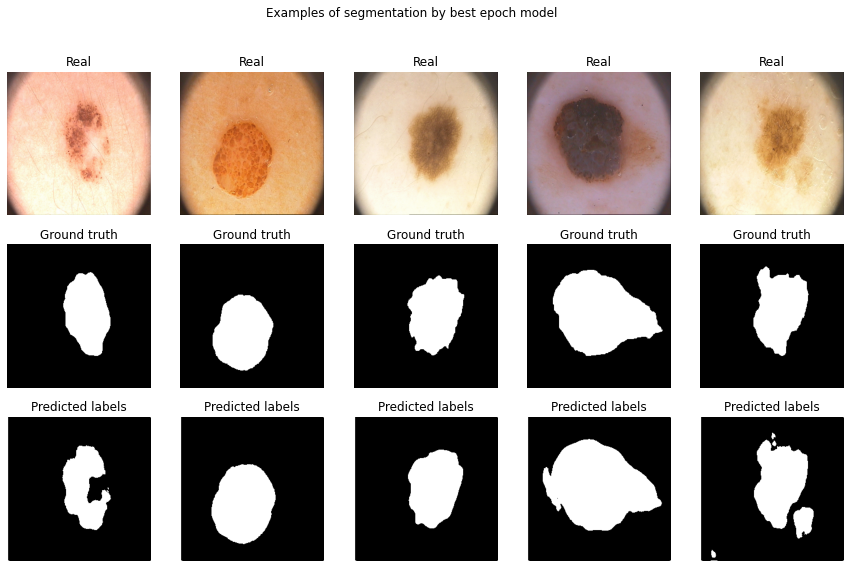

val_score_with_focal_loss: 0.7580000162124634
test_score_with_focal_loss: 0.7680000066757202


In [ ]:
model_name = "UNet_focal_loss"
model_fl_unet = UNet().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_fl_unet.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_fl_unet, iou_pytorch, data_val)
test_score = score_model(model_fl_unet, iou_pytorch, data_ts)

update_models_data("UNet & focal loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_fl_unet, title="Examples of segmentation by best epoch model")
print('val_score_with_focal_loss:', val_score)
print('test_score_with_focal_loss:', test_score)

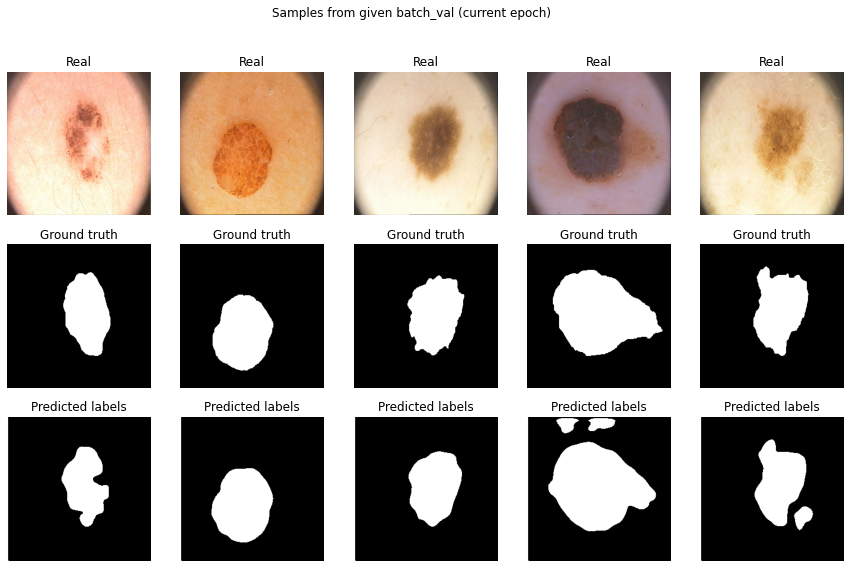

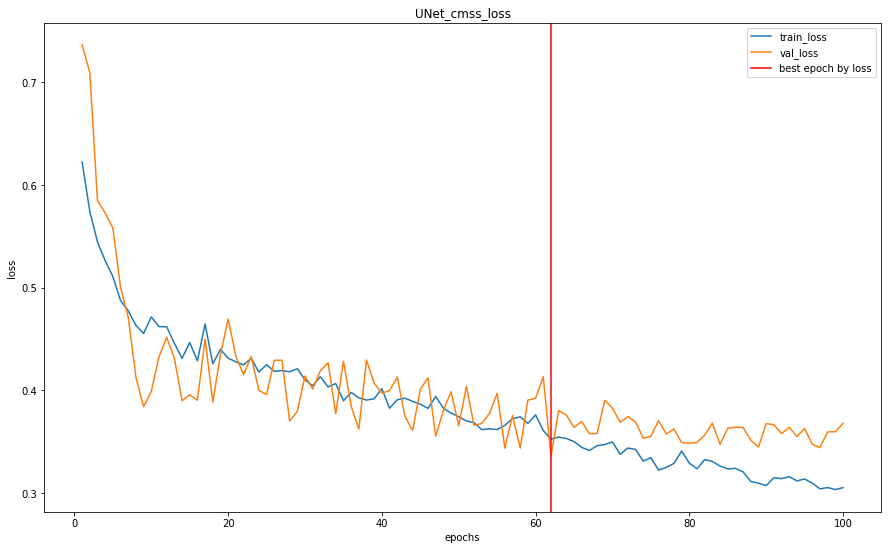

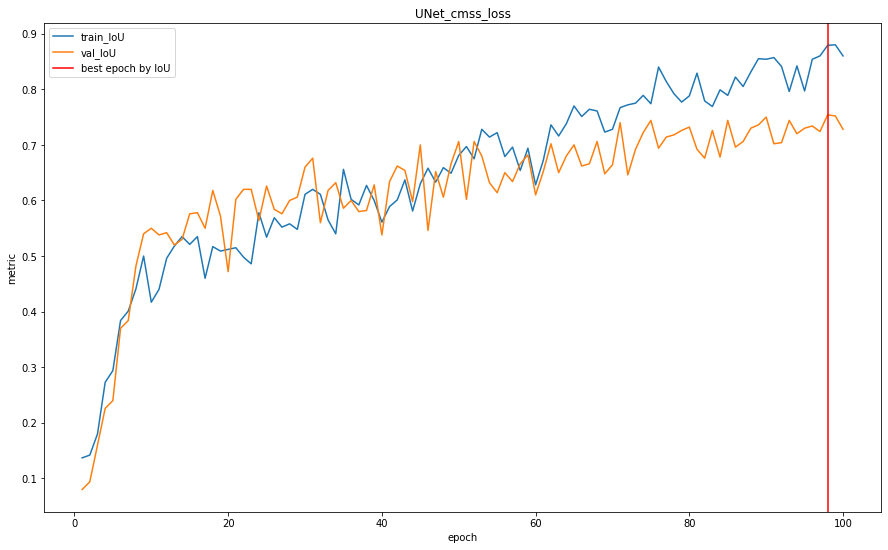

UNet_cmss_loss: best IoU value 0.7540000081062317 on 98 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_cmssl_unet = UNet().to(device)
model_name = "UNet_cmss_loss"
criterion = CorrelationMaximizedStructuralSimilarityLoss(channels=1).to(device)
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_cmssl_unet.parameters(), lr=1e-4) 

un_train_loss_with_cmssl, un_train_metrics_with_cmssl, un_val_loss_with_cmssl, un_val_metrics_with_cmssl = train_model(
    model_cmssl_unet, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un_train_loss_with_cmssl, un_train_metrics_with_cmssl, 
    un_val_loss_with_cmssl, un_val_metrics_with_cmssl,
    model_name=model_name)
print_best_epoch(
    un_val_metrics_with_cmssl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

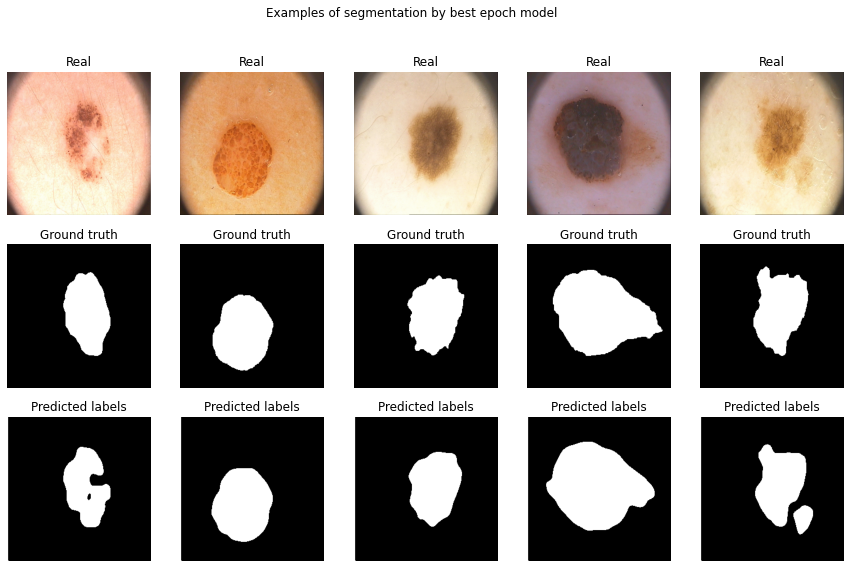

val_score_with_cmssl: 0.7540000081062317
test_score_with_cmssl: 0.75


In [ ]:
model_name = "UNet_cmss_loss"
model_cmssl_unet = UNet().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_cmssl_unet.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_cmssl_unet, iou_pytorch, data_val)
test_score = score_model(model_cmssl_unet, iou_pytorch, data_ts)

update_models_data("UNet & cmss loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_cmssl_unet, title="Examples of segmentation by best epoch model")
print('val_score_with_cmssl:', val_score)
print('test_score_with_cmssl:', test_score)

Новая модель путем изменения типа пулинга:

 **Max-Pooling** for the downsampling and **nearest-neighbor Upsampling** for the upsampling.

Down-sampling:

        conv = nn.Conv2d(3, 64, 3, padding=1)
        pool = nn.MaxPool2d(3, 2, padding=1)

Up-Sampling

        upsample = nn.Upsample(32)
        conv = nn.Conv2d(64, 64, 3, padding=1)

Замените max-pooling на convolutions с stride=2 и upsampling на transpose-convolutions с stride=2.


In [ ]:
class UNet2(nn.Module):
    def __init__(self):
        super().__init__()

        # encoder (downsampling)
        self.enc_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True)
        )  
        self.pool0 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=2, stride=2),
            nn.BatchNorm2d(num_features=64)
        )  # as in the original paper
        self.enc_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True)
        )  
        self.pool1 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=2, stride=2),
            nn.BatchNorm2d(num_features=128)
        )
        self.enc_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True)
        )  
        self.pool2 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=2, stride=2),
            nn.BatchNorm2d(num_features=256)
        )
        self.enc_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True)
        )  
        self.pool3 = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=2, stride=2),
            nn.BatchNorm2d(num_features=512)
        )

        # bottleneck
        self.bottleneck_conv = nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=1, padding=0, stride=1),
            nn.BatchNorm2d(num_features=1024),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=1, padding=0, stride=1),
            nn.BatchNorm2d(num_features=512),
            nn.ReLU(inplace=True)
        )

        # decoder (upsampling)
        self.upsample3 = nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=2, stride=2)
        self.dec_conv3 = nn.Sequential(
            nn.Conv2d(in_channels=512*2, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=256),
            nn.ReLU(inplace=True)
        )
        self.upsample2 = nn.ConvTranspose2d(in_channels=256, out_channels=256, kernel_size=2, stride=2)
        self.dec_conv2 = nn.Sequential(
            nn.Conv2d(in_channels=256*2, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=128),
            nn.ReLU(inplace=True)
        )
        self.upsample1 = nn.ConvTranspose2d(in_channels=128, out_channels=128, kernel_size=2, stride=2)
        self.dec_conv1 = nn.Sequential(
            nn.Conv2d(in_channels=128*2, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(inplace=True)
        )
        self.upsample0 = nn.ConvTranspose2d(in_channels=64, out_channels=64, kernel_size=2, stride=2)
        self.dec_conv0 = nn.Sequential(
            nn.Conv2d(in_channels=64*2, out_channels=1, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=1),
            nn.ReLU(inplace=True), 

            nn.Conv2d(in_channels=1, out_channels=1, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=1),
            nn.ReLU(inplace=True),

            nn.Conv2d(in_channels=1, out_channels=1, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(num_features=1)
        )

    def forward(self, x):
        # encoder
        e0 = self.enc_conv0(x)
        pooled = self.pool0(e0)
        e1 = self.enc_conv1(pooled)
        pooled = self.pool1(e1)
        e2 = self.enc_conv2(pooled)
        pooled = self.pool2(e2)
        e3 = self.enc_conv3(pooled)
        pooled = self.pool3(e3)

        # bottleneck
        b = self.bottleneck_conv(pooled)

        # decoder
        upsampled = self.upsample3(b)
        e3_cropped = center_crop(e3, upsampled.shape[-2:])
        concatenated = torch.cat((e3_cropped, upsampled), dim=1)
        d3 = self.dec_conv3(concatenated)
        upsampled = self.upsample2(d3)
        e2_cropped = center_crop(e2, upsampled.shape[-2:])
        concatenated = torch.cat((e2_cropped, upsampled), dim=1)
        d2 = self.dec_conv2(concatenated)
        upsampled = self.upsample1(d2)
        e1_cropped = center_crop(e1, upsampled.shape[-2:])
        concatenated = torch.cat((e1_cropped, upsampled), dim=1)
        d1 = self.dec_conv1(concatenated)
        upsampled = self.upsample0(d1)
        e0_cropped = center_crop(e0, upsampled.shape[-2:])
        concatenated = torch.cat((e0_cropped, upsampled), dim=1)
        d0 = self.dec_conv0(concatenated)  # no activation
        return d0

In [ ]:
from torchsummary import summary

model_2 = UNet2().to(device)
summary(model, (3, *size));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,928
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
         MaxPool2d-7         [-1, 64, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]          73,856
       BatchNorm2d-9        [-1, 128, 128, 128]             256
             ReLU-10        [-1, 128, 128, 128]               0
           Conv2d-11        [-1, 128, 128, 128]         147,584
      BatchNorm2d-12        [-1, 128, 128, 128]             256
             ReLU-13        [-1, 128, 128, 128]               0
        MaxPool2d-14          [-1, 128,

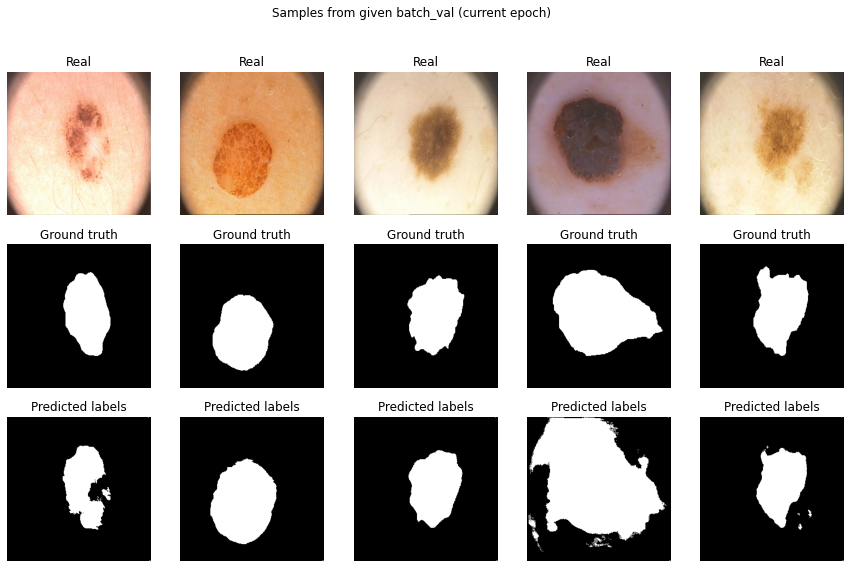

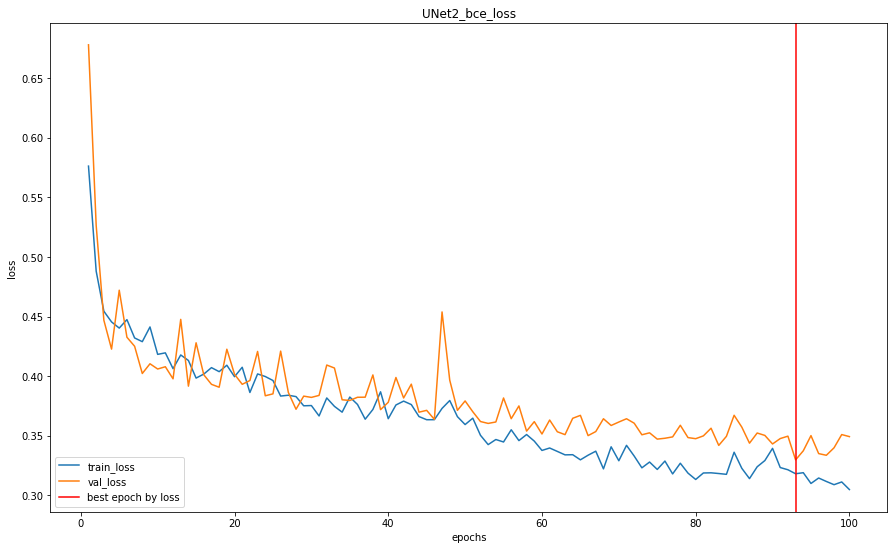

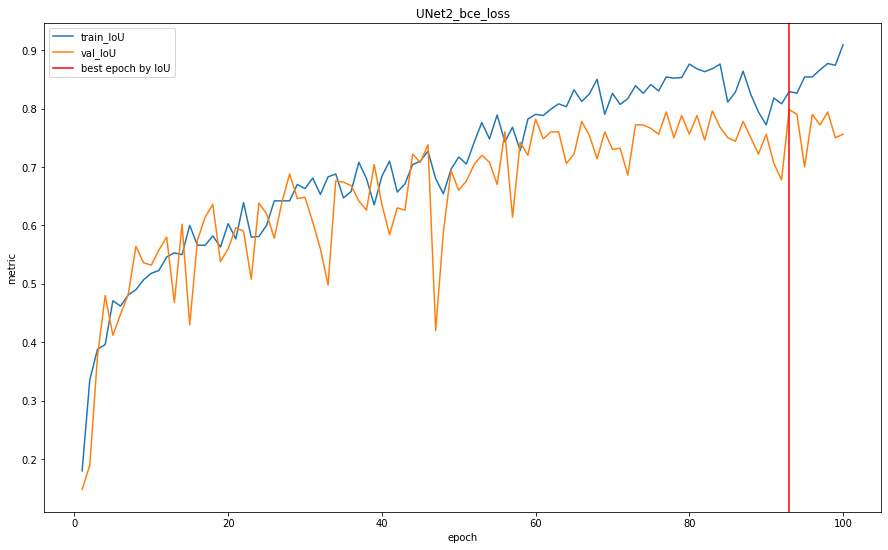

UNet2_bce_loss: best IoU value 0.7980000376701355 on 93 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_bce_unet2 = UNet2().to(device)
model_name = "UNet2_bce_loss"
criterion = bce_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_bce_unet2.parameters(), lr=1e-4) 

un2_train_loss_with_bce, un2_train_metrics_with_bce, un2_val_loss_with_bce, un2_val_metrics_with_bce = train_model(
    model_bce_unet2, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un2_train_loss_with_bce, un2_train_metrics_with_bce, 
    un2_val_loss_with_bce, un2_val_metrics_with_bce,
    model_name=model_name)
print_best_epoch(
    un2_val_metrics_with_bce[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

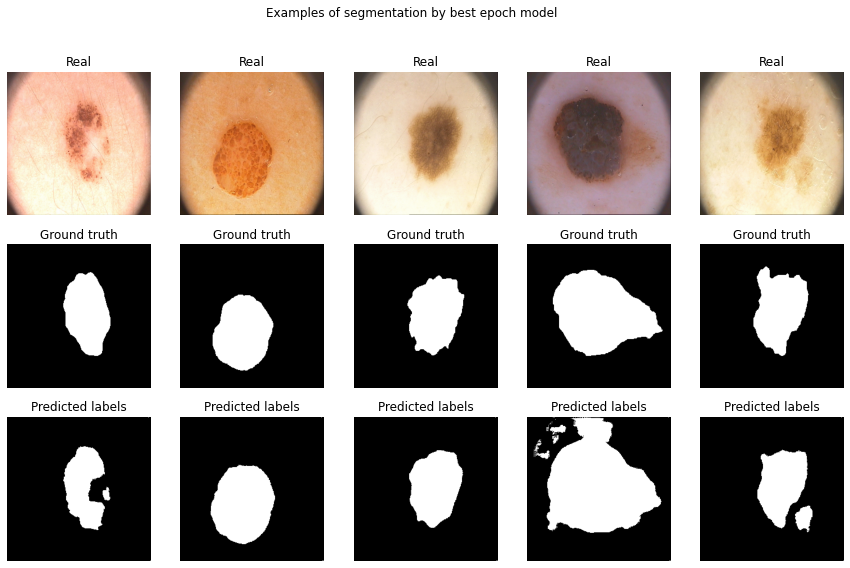

val_score_with_bce: 0.7980000376701355
test_score_with_bce: 0.8299999833106995


In [ ]:
model_name = "UNet2_bce_loss"
model_bce_unet2 = UNet2().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_bce_unet2.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_bce_unet2, iou_pytorch, data_val)
test_score = score_model(model_bce_unet2, iou_pytorch, data_ts)

update_models_data("UNet2 & bce loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_bce_unet2, title="Examples of segmentation by best epoch model")
print('val_score_with_bce:', val_score)
print('test_score_with_bce:', test_score)

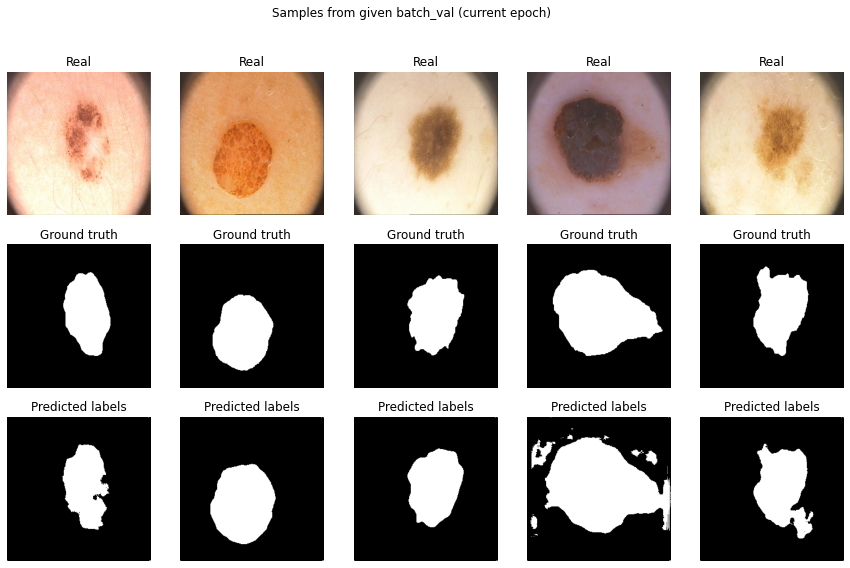

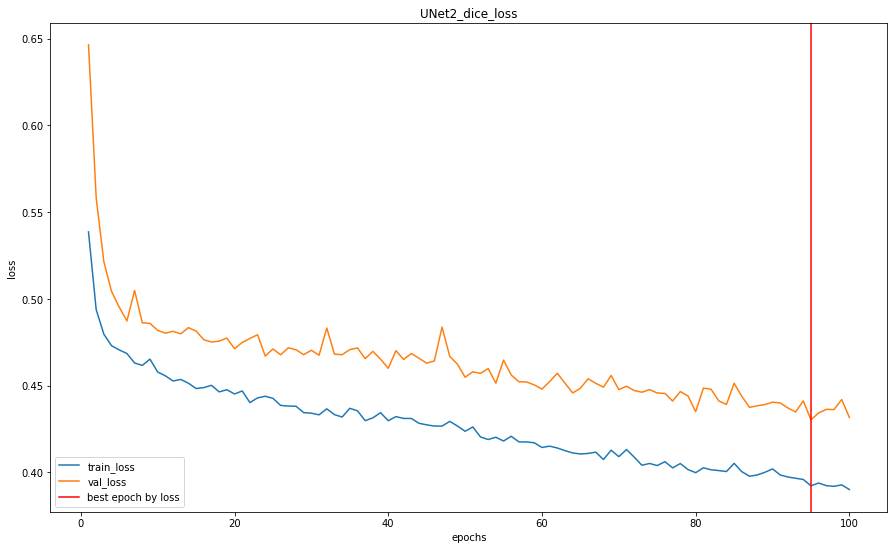

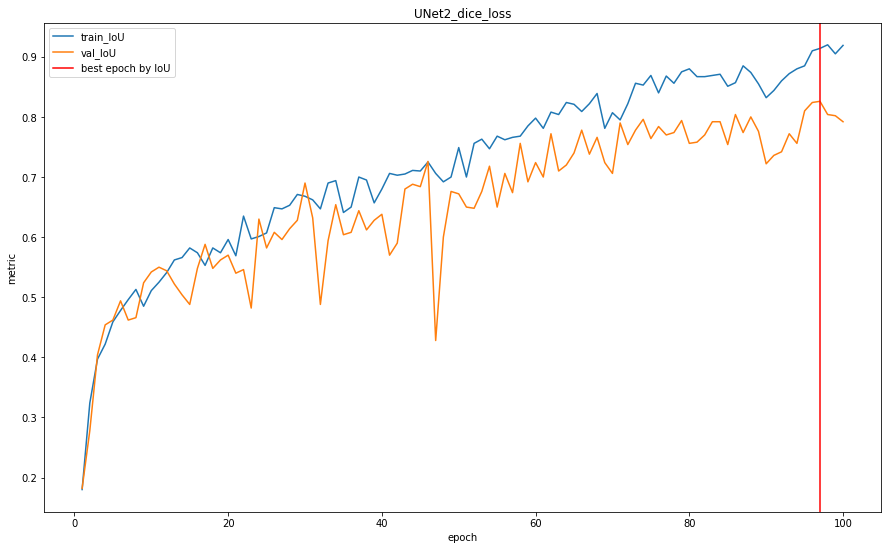

UNet2_dice_loss: best IoU value 0.8260000348091125 on 97 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_dice_unet2 = UNet2().to(device)
model_name = "UNet2_dice_loss"
criterion = dice_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_dice_unet2.parameters(), lr=1e-4) 

un2_train_loss_with_dl, un2_train_metrics_with_dl, un2_val_loss_with_dl, un2_val_metrics_with_dl = train_model(
    model_dice_unet2, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un2_train_loss_with_dl, un2_train_metrics_with_dl, 
    un2_val_loss_with_dl, un2_val_metrics_with_dl,
    model_name=model_name)
print_best_epoch(
    un2_val_metrics_with_dl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

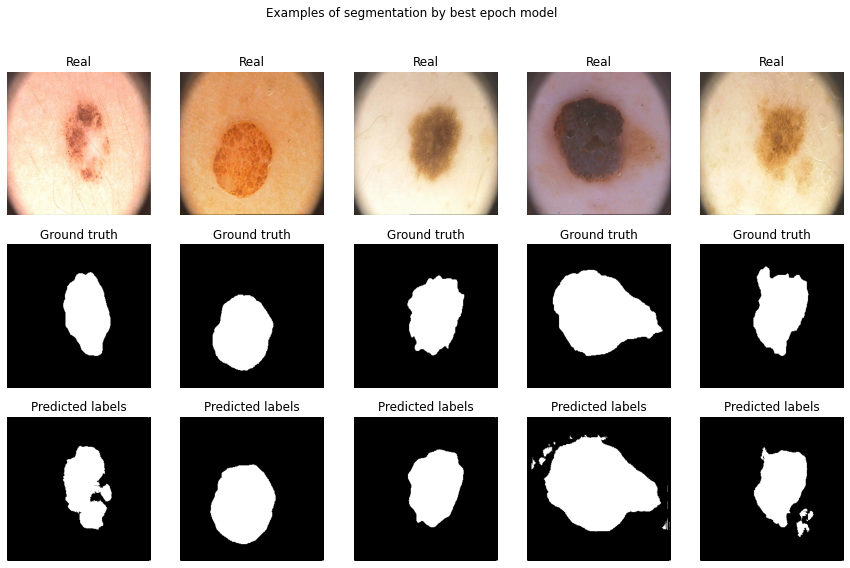

val_score_with_dice_loss: 0.8260000348091125
test_score_with_dice_loss: 0.7879999876022339


In [ ]:
model_name = "UNet2_dice_loss"
model_dice_unet2 = UNet2().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_dice_unet2.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_dice_unet2, iou_pytorch, data_val)
test_score = score_model(model_dice_unet2, iou_pytorch, data_ts)

update_models_data("UNet2 & dice loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_dice_unet2, title="Examples of segmentation by best epoch model")
print('val_score_with_dice_loss:', val_score)
print('test_score_with_dice_loss:', test_score)

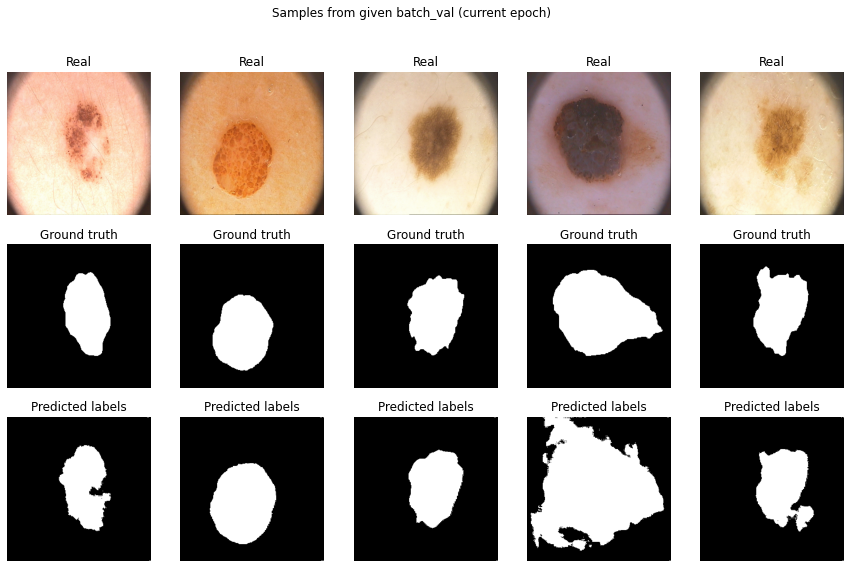

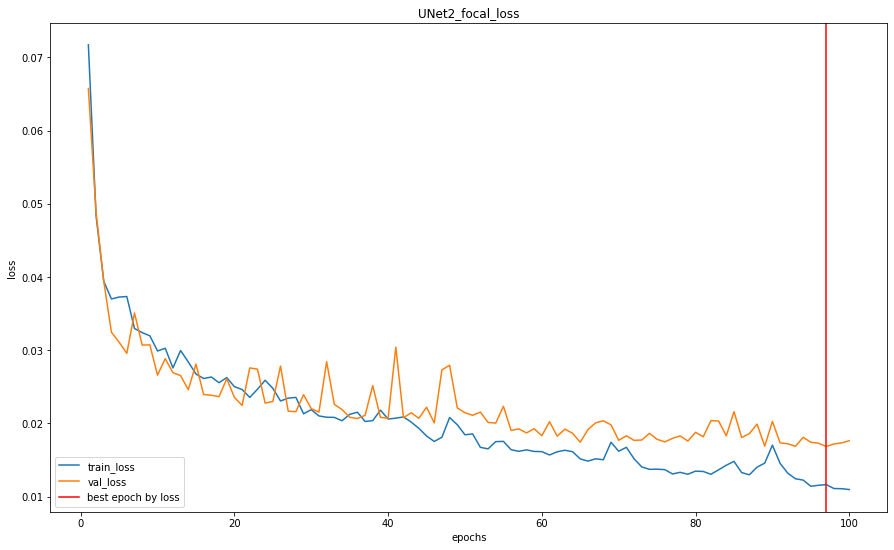

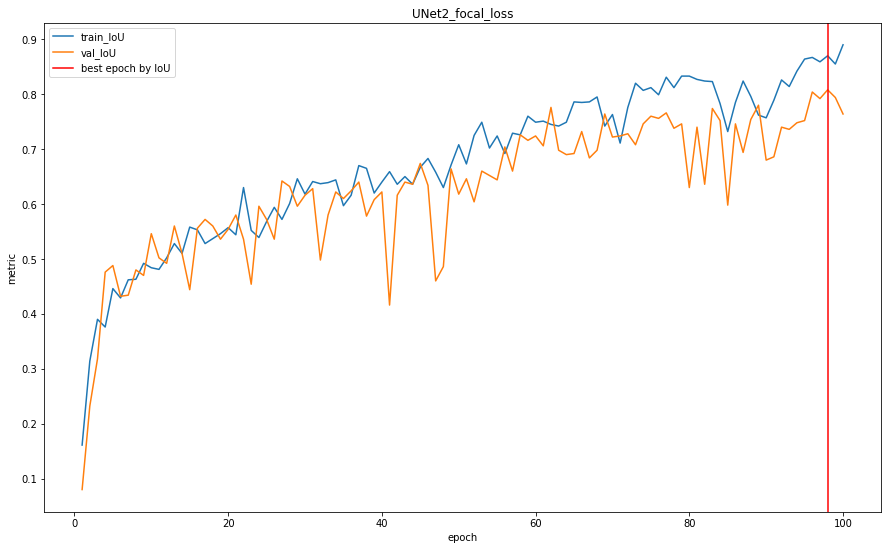

UNet2_focal_loss: best IoU value 0.8080000281333923 on 98 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_fl_unet2 = UNet2().to(device)
model_name = "UNet2_focal_loss"
criterion = focal_loss
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_fl_unet2.parameters(), lr=1e-4) 

un2_train_loss_with_fl, un2_train_metrics_with_fl, un2_val_loss_with_fl, un2_val_metrics_with_fl = train_model(
    model_fl_unet2, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un2_train_loss_with_fl, un2_train_metrics_with_fl, 
    un2_val_loss_with_fl, un2_val_metrics_with_fl,
    model_name=model_name)
print_best_epoch(
    un2_val_metrics_with_fl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

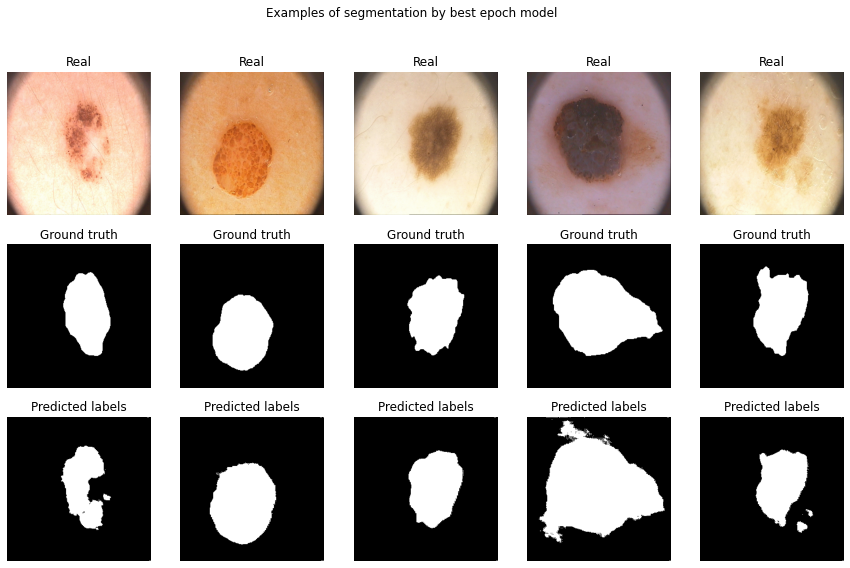

val_score_with_focal_loss: 0.8080000281333923
test_score_with_focal_loss: 0.8319999575614929


In [ ]:
model_name = "UNet2_focal_loss"
model_fl_unet2 = UNet2().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_fl_unet2.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_fl_unet2, iou_pytorch, data_val)
test_score = score_model(model_fl_unet2, iou_pytorch, data_ts)

update_models_data("UNet2 & focal loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_fl_unet2, title="Examples of segmentation by best epoch model")
print('val_score_with_focal_loss:', val_score)
print('test_score_with_focal_loss:', test_score)

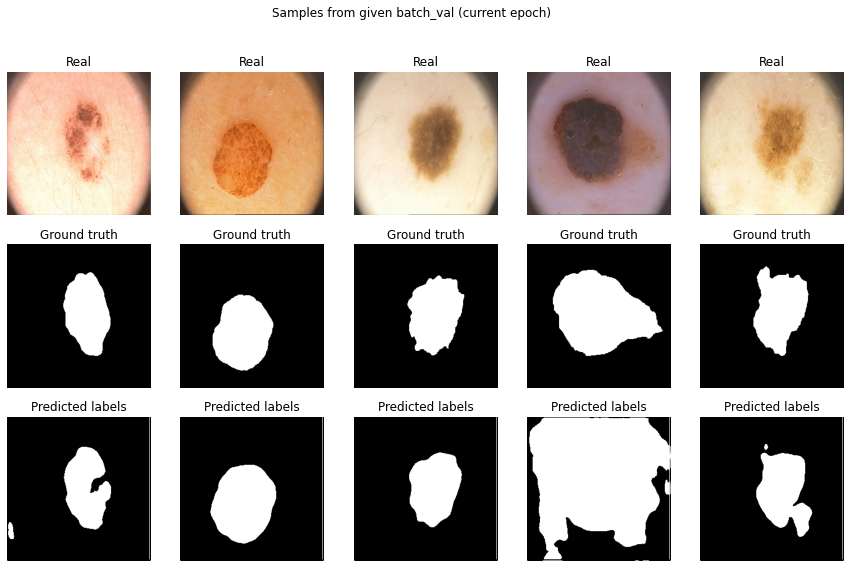

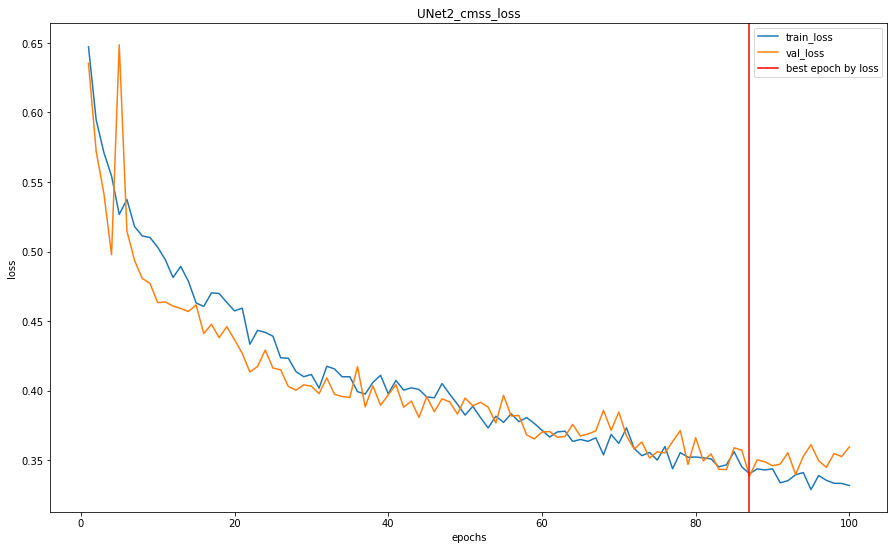

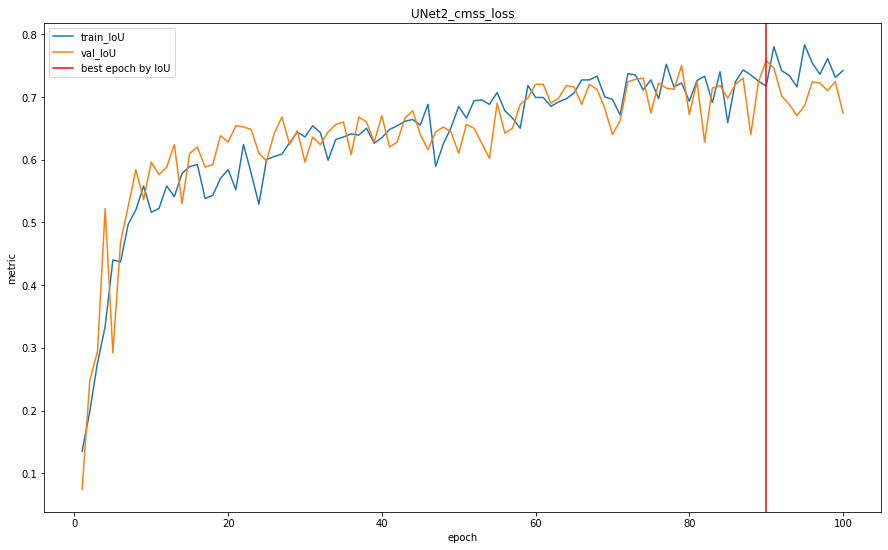

UNet2_cmss_loss: best IoU value 0.7580000162124634 on 90 epoch.


In [ ]:
enable_reproducibility()
torch.cuda.empty_cache()

model_cmssl_unet2 = UNet2().to(device)
model_name = "UNet2_cmss_loss"
criterion = CorrelationMaximizedStructuralSimilarityLoss(channels=1).to(device)
epochs = 100
user_metric_func = iou_pytorch
user_metric_name = 'IoU'
optimizer = torch.optim.Adam(model_cmssl_unet2.parameters(), lr=1e-4) 

un2_train_loss_with_cmssl, un2_train_metrics_with_cmssl, un2_val_loss_with_cmssl, un2_val_metrics_with_cmssl = train_model(
    model_cmssl_unet2, data_tr, data_val, criterion, optimizer, epochs, device,
    model_output_to_predict=one_class_get_labels,
    metrics={user_metric_name: user_metric_func}, main_metric_name=user_metric_name, save_best=True, model_name=model_name,
    print_samples_callback=show_some_samples)

show_plots(
    un2_train_loss_with_cmssl, un2_train_metrics_with_cmssl, 
    un2_val_loss_with_cmssl, un2_val_metrics_with_cmssl,
    model_name=model_name)
print_best_epoch(
    un2_val_metrics_with_cmssl[user_metric_name], metric_name=user_metric_name,
    model_name=model_name)

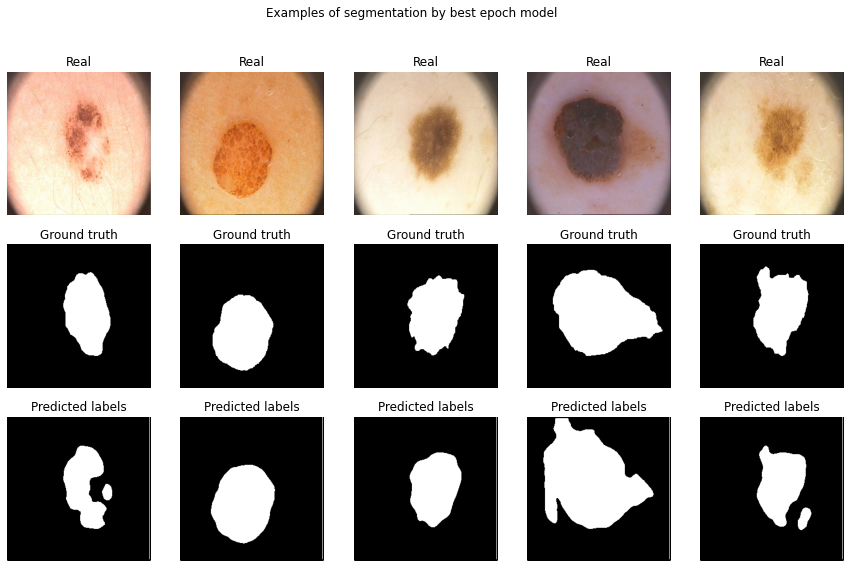

val_score_with_cmssl: 0.7580000162124634
test_score_with_cmssl: 0.7519999742507935


In [ ]:
model_name = "UNet2_cmss_loss"
model_cmssl_unet2 = UNet2().to(device)
state = load_model_state_and_info(model_name, TrainType.TRAIN, device)

model_cmssl_unet2.load_state_dict(state['model_state'])
best_epoch = state['epoch']
train_loss = state['loss']
val_score = score_model(model_cmssl_unet2, iou_pytorch, data_val)
test_score = score_model(model_cmssl_unet2, iou_pytorch, data_ts)

update_models_data("UNet2 & cmss loss", best_epoch, train_loss, val_score, test_score)

show_some_samples(model_cmssl_unet2, title="Examples of segmentation by best epoch model")
print('val_score_with_cmssl:', val_score)
print('test_score_with_cmssl:', test_score)

Сделайте вывод, какая из моделей лучше

In [ ]:
import pandas as pd


df = pd.DataFrame(models_data)
df.sort_values(by="test IoU", ascending=False, inplace=True)
print(df)

           model & loss  best epoch  train loss  val IoU  test IoU
1    SegNet & dice loss          97    0.423003    0.834     0.846
2   SegNet & focal loss          83    0.016201    0.826     0.840
0     SegNet & bce loss          83    0.325928    0.826     0.838
10   UNet2 & focal loss          98    0.017186    0.808     0.832
8      UNet2 & bce loss          93    0.329659    0.798     0.830
3    SegNet & cmss loss          98    0.394606    0.810     0.822
4       UNet & bce loss          80    0.365872    0.752     0.788
9     UNet2 & dice loss          97    0.436394    0.826     0.788
5      UNet & dice loss          78    0.452307    0.760     0.780
6     UNet & focal loss          83    0.018833    0.758     0.768
11    UNet2 & cmss loss          90    0.346209    0.758     0.752
7      UNet & cmss loss          98    0.359401    0.754     0.750


# Отчет (6 баллов): 
Ниже предлагается написать отчет о проделанно работе и построить графики для лоссов, метрик на валидации и тесте. 
Если вы пропустили какую-то часть в задании выше, то вы все равно можете получить основную часть баллов в отчете, если правильно зададите проверяемые вами гипотезы.


Аккуратно сравните модели между собой и соберите наилучшую архитектуру. Проверьте каждую модель с различными лоссами. Мы не ограничиваем вас в формате отчета, но проверяющий должен отчетливо понять для чего построен каждый график, какие выводы вы из него сделали и какой общий вывод можно сделать на основании данных моделей. Если вы захотите добавить что-то еще, чтобы увеличить шансы получения максимального балла, то добавляйте отдельное сравнение.

Дополнительные комментарии: 

Пусть у вас есть N обученных моделей.
- Является ли отчетом N графиков с 1 линей? Да, но очень низкокачественным, потому что проверяющий не сможет сам сравнить их.

- Является ли отчетом 1 график с N линиями? Да, но скорее всего таким образом вы отразили лишь один эффект. Этого мало, чтобы сделать досточно суждений по поводу вашей работа.

- Я проверял метрики на трейне, и привел в результате таблицу с N числами, что не так? ключейвой момент тут, что вы измеряли на трейне ваши метрики, уверены ли вы, что заивисмости останутся такими же на отложенной выборке?

- Я сделал отчет содержащий график лоссов и метрик, и у меня нет ошибок в основной части, но за отчет не стоит максимум, почему? Естестественно максимум баллов за отчет можно получить не за 2 графика (даже при условии их полной правильности). Проверяющий хочет видеть больше сравнений моделей, чем метрики и лоссы (особенно, если они на трейне).

Советы: попробуйте правильно поставить вопрос на который вы себе отвечаете и продемонстрировать таблицу/график, помогающий проверяющему увидеть ответ на этот вопрос. Пример: Ваня хочет узнать, с каким из 4-х лоссов модель (например, U-Net) имеет наилучшее качество. Что нужно сделать Ване? Обучить 4 одинаковых модели с разными лосс функциями. И измерить итогововое качество. Продемонстрировать результаты своих измерений и итоговый вывод. (warning: конечно же, это не идеально ответит на наш вопрос, так как мы не учитываем в экспериментах возможные различные типы ошибок, но для первого приближения этого вполне достаточно).

Примерное время на подготовку отчета 1 час, он содержит сравнеение метрик, график лоссов, выбор лучших моделей из нескольких кластеров и выбор просто лучшей модели, небольшой вывод по всему дз, возможно сравнение результирующих сегментаций, времени или числа параметров модели, проявляйте креативность.

##Отчет.

###Введение

В данном отчете представлены результаты анализа данных, полученных в ходе обучения нескольких (12 штук) моделей. Целью данного анализа данных является выбор наилучшей архитектуры в рамках поставленной учебной задачи. Для достижения поставленной цели предлагается решить следующие задачи: 

1. Анализ графиков лоссов и метрики IoU для каждого критерия (функции потерь) на трейне и валидации. 

2. Сравнение используемых архитектур по метрике IoU на валидации. 

3. Тестирование моделей с наилучшим показателем IoU, продемонстрированном на валидации, и сравнение результатов. 

В рамках отчета определим некоторые термины: 

1) под архитектурой будем понимать определенные комбинации слоев, блоков слоев (Segnet, Unet); 

2) под моделью будем понимать результат обучения по определенному критерию, представляющему собой функцию потерь, т.е. лосс, на основе которого она (модель) "штрафуется", в результате чего и происходит обучение;

3) под метрикой будем понимать некоторый параметр, характеризующий качество обучения модели в численном эквиваленте. 

###Анализ графиков лоссов и скора по метрике IoU для каждого критерия на трейне и валидации. 



Подгрузим статистику для анализа, вычертим графики и сравним их. На графиках для архитектур Segnet и двух версий Unet будут проиллюстрированы следующие лоссы: BCE, Dice, Focal, CMSS.

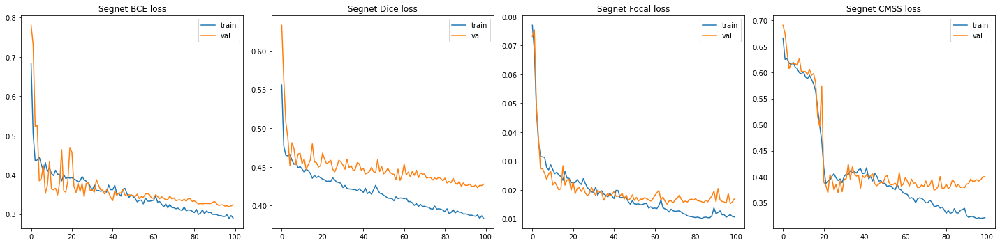

In [ ]:
train_stat_loss_sn = [sn_train_loss_with_bce, sn_train_loss_with_dl,
                      sn_train_loss_with_fl, sn_train_loss_with_cmssl]
val_stat_loss_sn = [sn_val_loss_with_bce, sn_val_loss_with_dl,
                    sn_val_loss_with_fl, sn_val_loss_with_cmssl]
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
axe = ax.ravel()
losses = ["BCE", "Dice", "Focal", "CMSS"]
for num, (train, val, loss) in enumerate(zip(train_stat_loss_sn, val_stat_loss_sn, losses)): 
  axe[num].plot(range(epochs), train, label=f'train')
  axe[num].plot(range(epochs), val, label=f'val')
  axe[num].set_title(f'Segnet {loss} loss')
  axe[num].legend()
plt.tight_layout()

По графикам лоссов для архитектуры Segnet можно отметить, что на дистанции в 100 эпох модели все-таки переобучается и на валидации по всем лоссам в целом выходит на "плато". Переобучение начинается примерно в интервале 50-60-й эпох, а по Dice loss - в районе 15-й эпохи. Наиболее экспрессивно оно проиллюстрировано на графике CMSS лосса, т.к. на нем после 50-й эпохи прослеживается тенденция на увеличение лосса по валидации при снижении ошибки на трейне. По BCE loss можно отметить наиболее амплитудные выбросы, прослеживающиеся в районе 20-й эпохи. Все имеющиеся выбросы носят скорее случайный характер, и в целом модель обучается достаточно стабильно. Исключение составляет модель, использующая в качестве лосса CMSS. 

Наиболее точной оказалась модель, использующая в качестве функции потерь Focal loss. Причем данная модель демонстрирует весьма солидный отрыв от всех остальных моделей. 

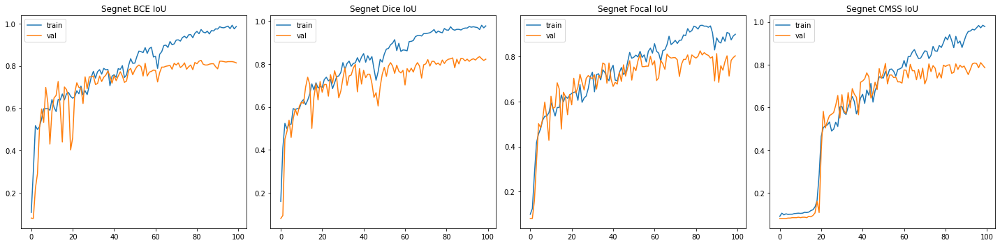

In [ ]:
train_stat_metric_sn = [sn_train_metrics_with_bce['IoU'], sn_train_metrics_with_dl['IoU'],
                      sn_train_metrics_with_fl['IoU'], sn_train_metrics_with_cmssl['IoU']]
val_stat_metric_sn = [sn_val_metrics_with_bce['IoU'], sn_val_metrics_with_dl['IoU'],
                    sn_val_metrics_with_fl['IoU'], sn_val_metrics_with_cmssl['IoU']]
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
axe = ax.ravel()
iou = 1
losses_met = ["BCE", "Dice", "Focal", "CMSS"]
for num, (train, val, loss) in enumerate(zip(train_stat_metric_sn, val_stat_metric_sn, losses_met)):
    axe[num].plot(range(epochs), train, label=f'train')
    axe[num].plot(range(epochs), val, label=f'val')
    axe[num].set_title(f'Segnet {loss} IoU')
    axe[num].legend()
plt.tight_layout()

Сразу же отметим, что именно архитектура Segnet в нашем исследовании оказалсь наиболее точной по метрике IoU. Наивысший скор на трейне имеют модели, использующие в качестве функции потерь BCE, Dice и CMSS лоссах, а наивысший скор на валидации - модель, использующая Dice loss, однако скор на BCE и Focal лоссах имеет достаточно близкое значение. Приведенные графики в целом подкрепляют мнение о склонности моделей к переобучению. 

В целом на дистанции в 100 эпох все модели сходятся и дальнейшее увеличение количества эпох не имеет рационального смысла. 

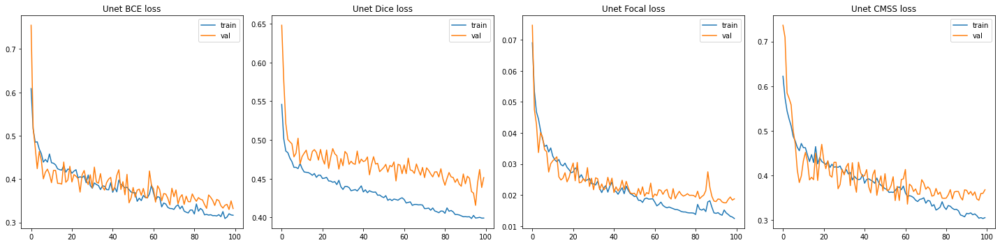

In [ ]:
train_stat_loss_un = [un_train_loss_with_bce, un_train_loss_with_dl,
                      un_train_loss_with_fl, un_train_loss_with_cmssl]
val_stat_loss_un = [un_val_loss_with_bce, un_val_loss_with_dl,
                    un_val_loss_with_fl, un_val_loss_with_cmssl]
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
axe = ax.ravel()
losses = ["BCE", "Dice", "Focal", "CMSS"]
for num, (train, val, loss) in enumerate(zip(train_stat_loss_un, val_stat_loss_un, losses)): 
  axe[num].plot(range(epochs), train, label=f'train')
  axe[num].plot(range(epochs), val, label=f'val')
  axe[num].set_title(f'Unet {loss} loss')
  axe[num].legend()
plt.tight_layout()

Архитектура Unet в общих чертах демонстрирует все те же результаты, что и Segnet: склонность к переобучению, наличие выбросов (которых здесь, кстати, гораздо больше), сходимость на трейне и валидации. Отметим, что модель в целом обучается, но достаточно нестабильно и лишь к 60-й эпохе можно отметить некоторую стабилизацию. Однако модели не лишаются случайных относительно амплитудных выбросов. 

Явным лидером является модель, использующая в качестве функции потерь Focal loss. Наиболее рано переобучение начинается у модели с Dice loss. 

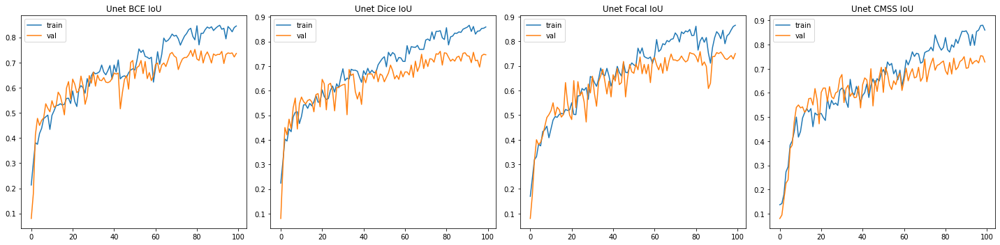

In [ ]:
train_stat_metric_un = [un_train_metrics_with_bce['IoU'], un_train_metrics_with_dl['IoU'],
                      un_train_metrics_with_fl['IoU'], un_train_metrics_with_cmssl['IoU']]
val_stat_metric_un = [un_val_metrics_with_bce['IoU'], un_val_metrics_with_dl['IoU'],
                    un_val_metrics_with_fl['IoU'], un_val_metrics_with_cmssl['IoU']]
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
axe = ax.ravel()
iou = 1
losses_met = ["BCE", "Dice", "Focal", "CMSS"]
for num, (train, val, loss) in enumerate(zip(train_stat_metric_un, val_stat_metric_un, losses_met)):
    axe[num].plot(range(epochs), train, label=f'train')
    axe[num].plot(range(epochs), val, label=f'val')
    axe[num].set_title(f'Unet {loss} IoU')
    axe[num].legend()
plt.tight_layout()

По метрике IoU для архитектуры Unet ситуация качественно схожа с Segnet, однако скор здесь меньше как на трейне, так и на валидации. На трейне лучше всего себя зарекомендовали модели, использующие в качестве функции потери Dice, Focal, CMSS лоссы, а на валидации - Unet & Dice loss и Unet & Focal loss, однако остальные модели с двумя оставшимися функциями потерь по скору не слишком далеки от лидеров. 

Решения менее стабильны, чем с использованием архитектуры Segnet, однако модели обучаются и по тренду выходят на "плато".

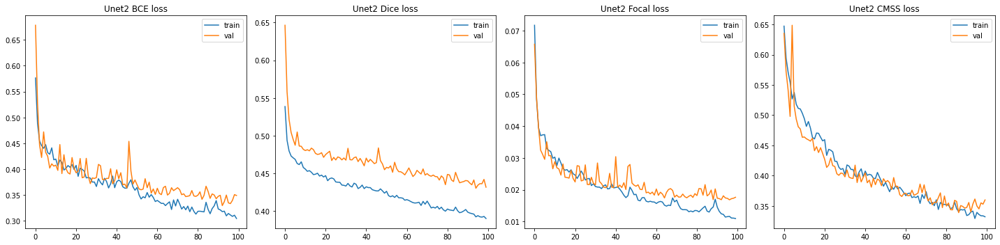

In [ ]:
train_stat_loss_un2 = [un2_train_loss_with_bce, un2_train_loss_with_dl,
                      un2_train_loss_with_fl, un2_train_loss_with_cmssl]
val_stat_loss_un2 = [un2_val_loss_with_bce, un2_val_loss_with_dl,
                    un2_val_loss_with_fl, un2_val_loss_with_cmssl]
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
axe = ax.ravel()
losses = ["BCE", "Dice", "Focal", "CMSS"]
for num, (train, val, loss) in enumerate(zip(train_stat_loss_un2, val_stat_loss_un2, losses)): 
  axe[num].plot(range(epochs), train, label=f'train')
  axe[num].plot(range(epochs), val, label=f'val')
  axe[num].set_title(f'Unet2 {loss} loss')
  axe[num].legend()
plt.tight_layout()

Unet2, по сравнению со своим предшественником, демонстрирует более стабильное решение поставленной задачи и меньшее количество выбросов. Переобучение весьма незначительно.  

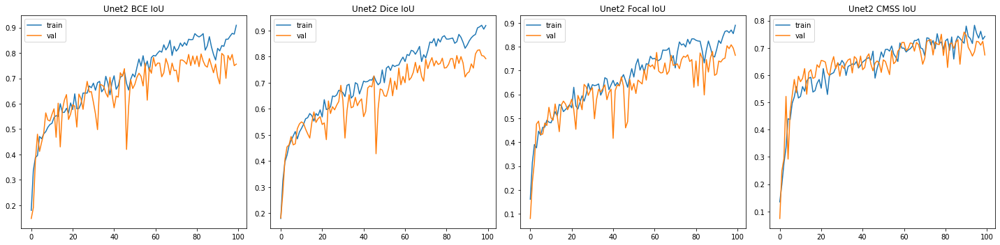

In [ ]:
train_stat_metric_un2 = [un2_train_metrics_with_bce['IoU'], un2_train_metrics_with_dl['IoU'],
                      un2_train_metrics_with_fl['IoU'], un2_train_metrics_with_cmssl['IoU']]
val_stat_metric_un2 = [un2_val_metrics_with_bce['IoU'], un2_val_metrics_with_dl['IoU'],
                    un2_val_metrics_with_fl['IoU'], un2_val_metrics_with_cmssl['IoU']]
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
axe = ax.ravel()
iou = 1
losses_met = ["BCE", "Dice", "Focal", "CMSS"]
for num, (train, val, loss) in enumerate(zip(train_stat_metric_un2, val_stat_metric_un2, losses_met)):
    axe[num].plot(range(epochs), train, label=f'train')
    axe[num].plot(range(epochs), val, label=f'val')
    axe[num].set_title(f'Unet2 {loss} IoU')
    axe[num].legend()
plt.tight_layout()

По IoU метрике отметим наличие амплитудных просадок, что не мешает, в частности, модели, использующей в качестве функции потерь Dice loss, соперничать с архитектурой SegNet на валидации. 

В целом, отметим, что данный вариант архитектуры Unet более конкурентоспособен, чем предыдущий. 

###Сравнение трех архитектур по метрике IoU на валидации.

Подгрузим статистику для каждой из трех архитектур на валидации по метрике IoU и взглянем на проблему под несколько другим углом. 

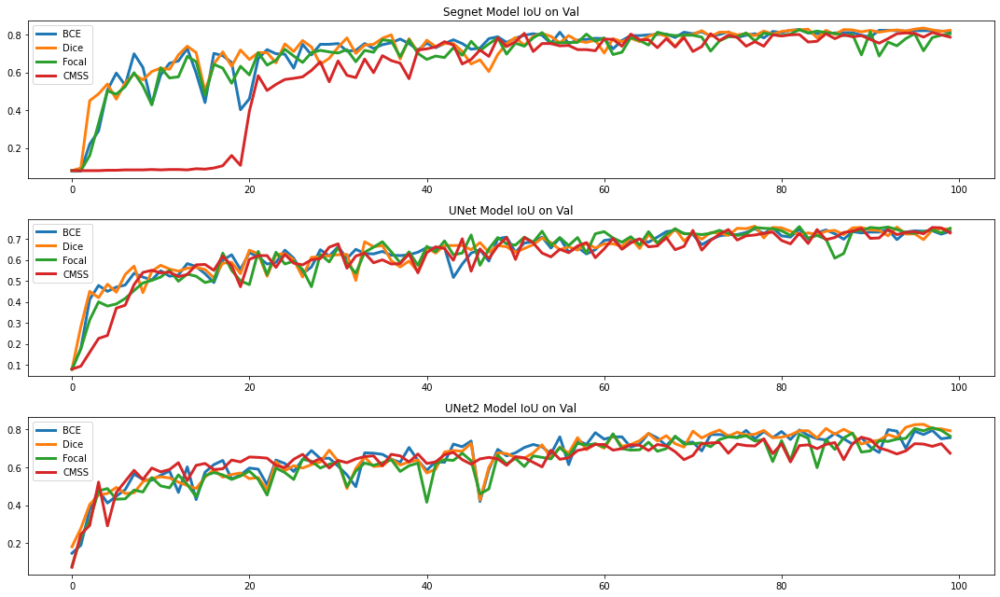

In [ ]:
val_metrics_with_bce = [sn_val_metrics_with_bce['IoU'], un_val_metrics_with_bce['IoU'], un2_val_metrics_with_bce['IoU']]
val_metrics_with_dl = [sn_val_metrics_with_dl['IoU'], un_val_metrics_with_dl['IoU'], un2_val_metrics_with_dl['IoU']]
val_metrics_with_fl = [sn_val_metrics_with_fl['IoU'], un_val_metrics_with_fl['IoU'], un2_val_metrics_with_fl['IoU']]
val_metrics_with_cmssl = [sn_val_metrics_with_cmssl['IoU'], un_val_metrics_with_cmssl['IoU'], un2_val_metrics_with_cmssl['IoU']]

fig, ax = plt.subplots(3, 1, figsize=(15, 9))
axe = ax.ravel()
models = ['Segnet', 'UNet', 'UNet2']
for num, (bce, dice, focal, cmss, model) in enumerate(zip(val_metrics_with_bce, 
                                                          val_metrics_with_dl, 
                                                          val_metrics_with_fl,
                                                          val_metrics_with_cmssl, 
                                                          models)):
  axe[num].plot(range(epochs), bce, label=f'BCE', linewidth=3)
  axe[num].plot(range(epochs), dice, label=f'Dice', linewidth=3)
  axe[num].plot(range(epochs), focal, label=f'Focal', linewidth=3)
  axe[num].plot(range(epochs), cmss, label=f'CMSS', linewidth=3)
  axe[num].set_title(f'{model} Model IoU on Val')
  axe[num].legend()
plt.tight_layout()

Можем видеть, что модели, использующие в качестве функции потерь CMSS loss, обучаются с некоторым отставанием, что наиболее заметно на примере архитектуры Segnet. 

Также отметим, что на выходе модели, основанные на архитектуре Segnet, явно вышли на "плато" и стабилизировались, за исключением модели, использующей Focal loss, однако здесь скорее имеет место просадка по метрике, т.к. модели с Focal loss в целом склонны к более быстрому обучению. В это время модели, основанные на архитектуре Unet, потенциально могут немного повысить свой скор, т.к. в целом трендовая линия моделей еще не вышла на "плато". Последнее в большей степени касается первого варианта реализации архитектуры Unet, т.е. ее имеет смысл попробовать обучать дальше. В данной работе это не реализовано, поскольку данная архитектура зарекомендовала себя как наименее предпочтительная. 

###Тесты моделей с наилучшим показателем IoU, продемонстрированном на валидации, и сравнение результатов. 

Подгрузим скоры лучших эпох всех моделей и выведем соответствующие диаграммы. 

In [ ]:
best_model_segnet_with_bce_test = score_model(model_bce, iou_pytorch, data_ts)
best_model_segnet_with_dice_test = score_model(model_dice, iou_pytorch, data_ts)
best_model_segnet_with_fl_test = score_model(model_fl, iou_pytorch, data_ts)
best_model_segnet_with_cmssl_test = score_model(model_cmssl, iou_pytorch, data_ts)

best_model_unet_with_bce_test = score_model(model_bce_unet, iou_pytorch, data_ts)
best_model_unet_with_dice_test = score_model(model_dice_unet, iou_pytorch, data_ts)
best_model_unet_with_fl_test = score_model(model_fl_unet, iou_pytorch, data_ts)
best_model_unet_with_cmssl_test = score_model(model_cmssl_unet, iou_pytorch, data_ts)

best_model_unet2_with_bce_test = score_model(model_bce_unet2, iou_pytorch, data_ts)
best_model_unet2_with_dice_test = score_model(model_dice_unet2, iou_pytorch, data_ts)
best_model_unet2_with_fl_test = score_model(model_fl_unet2, iou_pytorch, data_ts)
best_model_unet2_with_cmssl_test = score_model(model_cmssl_unet2, iou_pytorch, data_ts)

result = pd.DataFrame({'Segnet': [best_model_segnet_with_bce_test, best_model_segnet_with_dice_test, 
                                  best_model_segnet_with_fl_test, best_model_segnet_with_cmssl_test],
                       'Unet': [best_model_unet_with_bce_test, best_model_unet_with_dice_test, 
                                   best_model_unet_with_fl_test, best_model_unet_with_cmssl_test],
                       'Unet2': [best_model_unet2_with_bce_test, best_model_unet2_with_dice_test, 
                                   best_model_unet2_with_fl_test, best_model_unet2_with_cmssl_test]}, 
                      index=losses_met)

In [ ]:
#!pip install matplotlib --upgrade
print('matplotlib: {}'.format(matplotlib.__version__))

matplotlib: 3.2.2


Нужен matplotlib v. 3.4, чтобы отобразить значения для каждого бара. Установить не получилось, поэтому в коде цикл на подписи баров не активен. 

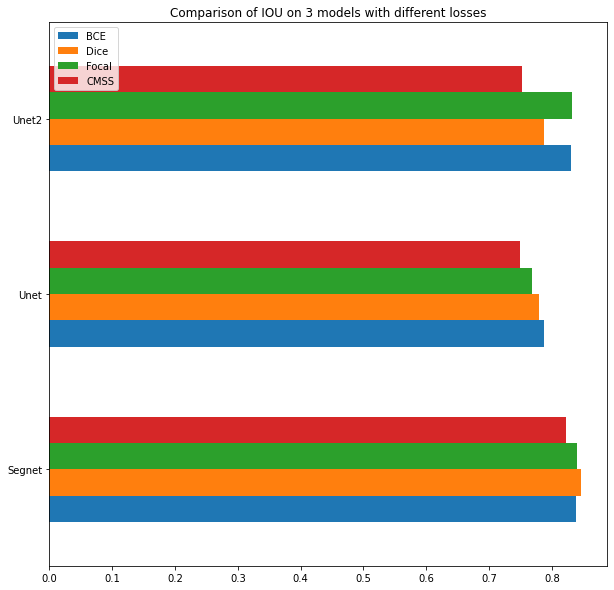

In [ ]:
fig, ax = plt.subplots()
result.T.plot(kind='barh', figsize=(10, 10), width=0.6, title='', ax=ax)
ax.set_title('Comparison of IOU on 3 models with different losses')
ax.legend(loc='upper left')

#for i in range(len(losses_met)):
    
    #ax.bar_label(ax.containers[i], fmt='%.2f')

In [ ]:
import pandas as pd


df = pd.DataFrame(models_data)
df.sort_values(by="test IoU", ascending=False, inplace=True)
print(df)

           model & loss  best epoch  train loss  val IoU  test IoU
1    SegNet & dice loss          97    0.423003    0.834     0.846
2   SegNet & focal loss          83    0.016201    0.826     0.840
0     SegNet & bce loss          83    0.325928    0.826     0.838
10   UNet2 & focal loss          98    0.017186    0.808     0.832
8      UNet2 & bce loss          93    0.329659    0.798     0.830
3    SegNet & cmss loss          98    0.394606    0.810     0.822
4       UNet & bce loss          80    0.365872    0.752     0.788
9     UNet2 & dice loss          97    0.436394    0.826     0.788
5      UNet & dice loss          78    0.452307    0.760     0.780
6     UNet & focal loss          83    0.018833    0.758     0.768
11    UNet2 & cmss loss          90    0.346209    0.758     0.752
7      UNet & cmss loss          98    0.359401    0.754     0.750


Как можно заметить, тесты не преподнесли сюрпризов. Отметим, что в подавляющем большинстве случаев скор по метрике IoU на тестовой выборке выше, чем на валидационной. Наиболее предпочтительна архитектура SegNet с моделями, использующими в качестве функции потерь Dice loss, Focal loss и BCE loss. Достаточно хороший скор продемонстрирован на архитектуре Unet2 моделями с Focal loss и BCE. Неплохой скор продемонстрировала модель с CMSS loss на архитектуре SegNet. Остальные модели имеют более низкий скор по метрике.

###Заключение

В целом, по трем архитектурам, отметим, что модели, использующие в качестве функции потерь Focal loss, обучаются быстрее и имеют погрешности на порядок меньше, если сравнивать с остальными моделями. Наиболее стабильны модели, использующие BCE loss и Dice loss, однако модели с BCE loss еще и демонстрируют меньшую погрешность модели. 

Скор по метрике IoU оказывается выше у моделей, использующих в качестве функций потерь Focal loss и Dice loss. Явным аутсайдером в гонке является функция потерь CMSS - она наименее предпочтительна, однако в случае ее применения к архитектуре Unet2 стоит отметить отсутствие явного переобучения. 

В выборе наиболее предпочтительной архитектуры явным фаворитом является Segnet. Но здесь стоит оговориться: во-первых, мы имеем небольшую выборку, которую еще и засплитили на трейновую, валидационную и тестовую; во-вторых, преимущественное переобучение моделей, которое почти наверняка связано, опять же, с малочисленностью элементов в исходной выборке; в-третьих, несбалансированность данных (родинок и кожных дефектов меньше, чем фона). Поэтому стоит отметить стабильность архитектуры Unet2 и ее хорошее взаимодействие с функцией потерь CMSS. 

Вообще, в силу указанных выше причин, качество обучения зависит еще и от того, как сгенерируются батчи в обучающей выборке. Т.е. если запустить обучение моделей заново, то качество может довольно сильно поменяться. Связно это с тем, что при малой мощности исходной выборки, все зависит от того, какие изображения окажутся в батчах, т.е. модель может выучить паттерны либо не слишком хорошо и качество понизится, либо слишком хорошо и тогда качество повысится. Отметим, что у повышения качества на тестовой выборке будет "потолок", т.к. данных все-таки маловато, чтобы идеально выучить некоторые признаки. Также в нашей ситуации важно подобрать размер батча. С точки зрения оперативности и качества отработки, оптимальный размер батча в рамках нашего исследования - от 5 до 7 изображений. Если увеличивать размер батча дальше, то произойдет существенная просадка по качеству на тестовой выборке, т.к. в таком случае модель, вероятно, выучивает меньше признаков и оказывается не готова работать с новым (тестовым) набором данных. А уменьшение размеров батча нерационально. 

Ожидалось, что модели со skip-connections будут выдавать лучшие результаты. Однако в рамках нашего решения задачи оказалось, что более простая архитектура Segnet выдает наивысшие скоры и демонстрирует наибольшую стабильность. 